In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import asapy

from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import pairwise_distances
from sklearn.manifold import TSNE
from sklearn import datasets
from seaborn import load_dataset

# Aprendizado Supervisionado

## Classificação

### Caso 1: [Titanic](https://www.kaggle.com/competitions/titanic)

In [2]:
df_titanic = load_dataset('titanic')
df_titanic.drop(columns=['deck', 'age'], inplace=True)

In [3]:
sample_titanic = df_titanic.sample(10)
df_titanic.drop(sample_titanic.index, inplace=True)

In [4]:
df_titanic.head(5)

,survived,pclass,sex,sibsp,parch,fare,embarked,class,who,adult_male,embark_town,alive,alone
0,0,3,male,1,0,7.2500,S,Third,man,True,Southampton,no,False
1,1,1,female,1,0,71.2833,C,First,woman,False,Cherbourg,yes,False
2,1,3,female,0,0,7.9250,S,Third,woman,False,Southampton,yes,True
3,1,1,female,1,0,53.1000,S,First,woman,False,Southampton,yes,False
4,0,3,male,0,0,8.0500,S,Third,man,True,Southampton,no,True


#### Rede Neural

##### Uso Simples

In [5]:
nn_titanic = asapy.NeuralNetwork(target="survived")

In [6]:
nn_titanic.build(df_titanic)

In [7]:
nn_titanic.hyperparameter_optimization()

In [8]:
a = nn_titanic.fit()

In [9]:
pred_nn_titanic = nn_titanic.predict(sample_titanic)

Inference time: 113.77 milliseconds (10 register(s))


In [10]:
pred_nn_titanic

,pclass,sex,sibsp,parch,fare,embarked,class,who,adult_male,embark_town,alive,alone,survived,survived (NN prediction)
827,2,male,0,2,37.0042,C,Second,child,False,Cherbourg,yes,False,1,1
467,1,male,0,0,26.5500,S,First,man,True,Southampton,no,True,0,0
209,1,male,0,0,31.0000,C,First,man,True,Cherbourg,yes,True,1,1
466,2,male,0,0,0.0000,S,Second,man,True,Southampton,no,True,0,0
95,3,male,0,0,8.0500,S,Third,man,True,Southampton,no,True,0,0
762,3,male,0,0,7.2292,C,Third,man,True,Cherbourg,yes,True,1,1
528,3,male,0,0,7.9250,S,Third,man,True,Southampton,no,True,0,0
445,1,male,0,2,81.8583,S,First,child,False,Southampton,yes,False,1,1
511,3,male,0,0,8.0500,S,Third,man,True,Southampton,no,True,0,0
283,3,male,0,0,8.0500,S,Third,man,True,Southampton,yes,True,1,1


##### Uso personalizado (uso de argumentos opcionais)

In [11]:
nn_titanic = asapy.NeuralNetwork(target="survived", name='demo_nn_titanic', seed=25)

In [12]:
nn_titanic.build(
    df_titanic,
    task='classification',
    max_cat_nunique = 10,
    split_size = (0.7, 0.15, 0.15),
    info=True,
    patience_early_stopping = 20,
    patience_reduceLR = 4,
    metrics=['auc', 'precision', 'recall', 'accuracy']
)


                Task: classification

                Total of registers: 881
                Total of valid registers: 879
                Total of invalid registers: 2

                Total of training registers: 615
                Total of validation registers: 132
                Total of test registers: 132

                Features before preprocessing: 12
                Features after preprocessing: 24

                Numerical Features: ['pclass', 'sibsp', 'parch', 'fare']
                Categorical Features: ['sex', 'embarked', 'class', 'who', 'adult_male', 'embark_town', 'alive', 'alone']
                Categorical Features removed due to high cardinality: []

                Target: ['survived']
            	Cardinality (Target): 2


In [13]:
nn_titanic.hyperparameter_optimization(
    n_trials=5,
    num_folds=5,
    info=True,
    search_space_dropout = [0.0, 0.5],
    search_space_layers = [2, 3, 4],
    search_space_batch_size = [32, 64],
    search_space_optimizer = ['Adam']
)

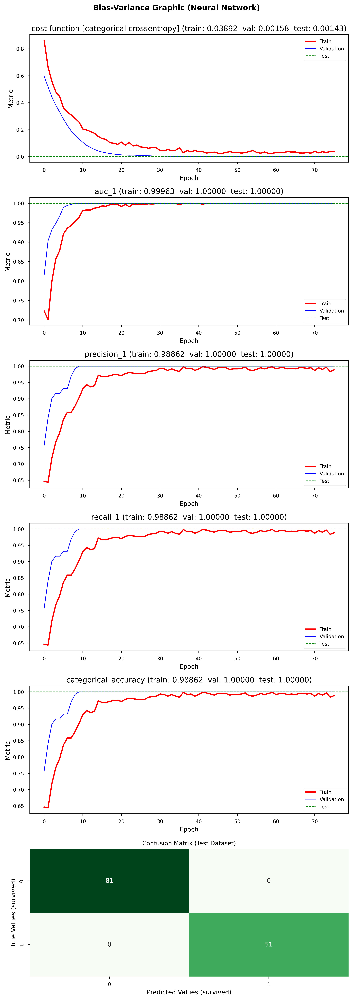

In [14]:
history_nn_titanic = nn_titanic.fit(return_history=True, graphic=True, graphic_save_extension='png', verbose=0)

In [15]:
pred_nn_titanic = nn_titanic.predict(sample_titanic, verbose=0)

Inference time: 63.24 milliseconds (10 register(s))


In [16]:
pred_nn_titanic

,pclass,sex,sibsp,parch,fare,embarked,class,who,adult_male,embark_town,alive,alone,survived,survived (NN prediction)
827,2,male,0,2,37.0042,C,Second,child,False,Cherbourg,yes,False,1,1
467,1,male,0,0,26.5500,S,First,man,True,Southampton,no,True,0,0
209,1,male,0,0,31.0000,C,First,man,True,Cherbourg,yes,True,1,1
466,2,male,0,0,0.0000,S,Second,man,True,Southampton,no,True,0,0
95,3,male,0,0,8.0500,S,Third,man,True,Southampton,no,True,0,0
762,3,male,0,0,7.2292,C,Third,man,True,Cherbourg,yes,True,1,1
528,3,male,0,0,7.9250,S,Third,man,True,Southampton,no,True,0,0
445,1,male,0,2,81.8583,S,First,child,False,Southampton,yes,False,1,1
511,3,male,0,0,8.0500,S,Third,man,True,Southampton,no,True,0,0
283,3,male,0,0,8.0500,S,Third,man,True,Southampton,yes,True,1,1


##### Salvar modelo treinado

In [17]:
nn_titanic.save()

##### Recuperar modelo treinado

In [18]:
foldername_nn_titanic = 'demo_nn_titanic'

In [19]:
nn_titanic_loaded = asapy.NeuralNetwork(target="survived")

In [20]:
nn_titanic_loaded.load(foldername_nn_titanic)

In [21]:
pred_nn_titanic_loaded = nn_titanic_loaded.predict(sample_titanic, verbose=0)

Inference time: 91.14 milliseconds (10 register(s))


In [22]:
pred_nn_titanic_loaded

,pclass,sex,sibsp,parch,fare,embarked,class,who,adult_male,embark_town,alive,alone,survived,survived (NN prediction)
827,2,male,0,2,37.0042,C,Second,child,False,Cherbourg,yes,False,1,1
467,1,male,0,0,26.5500,S,First,man,True,Southampton,no,True,0,0
209,1,male,0,0,31.0000,C,First,man,True,Cherbourg,yes,True,1,1
466,2,male,0,0,0.0000,S,Second,man,True,Southampton,no,True,0,0
95,3,male,0,0,8.0500,S,Third,man,True,Southampton,no,True,0,0
762,3,male,0,0,7.2292,C,Third,man,True,Cherbourg,yes,True,1,1
528,3,male,0,0,7.9250,S,Third,man,True,Southampton,no,True,0,0
445,1,male,0,2,81.8583,S,First,child,False,Southampton,yes,False,1,1
511,3,male,0,0,8.0500,S,Third,man,True,Southampton,no,True,0,0
283,3,male,0,0,8.0500,S,Third,man,True,Southampton,yes,True,1,1


#### XG Boost

##### Uso Simples

In [23]:
xgb_titanic = asapy.XgBoost(target="survived")

In [24]:
xgb_titanic.build(df_titanic)

In [25]:
xgb_titanic.hyperparameter_optimization()

In [26]:
xgb_titanic.fit()

In [27]:
pred_xgb_titanic = xgb_titanic.predict(sample_titanic)

Inference time: 9.81 milliseconds (10 register(s))


In [28]:
pred_xgb_titanic

,pclass,sex,sibsp,parch,fare,embarked,class,who,adult_male,embark_town,alive,alone,survived,survived (XGB prediction)
827,2,male,0,2,37.0042,C,Second,child,False,Cherbourg,yes,False,1,1
467,1,male,0,0,26.5500,S,First,man,True,Southampton,no,True,0,0
209,1,male,0,0,31.0000,C,First,man,True,Cherbourg,yes,True,1,0
466,2,male,0,0,0.0000,S,Second,man,True,Southampton,no,True,0,0
95,3,male,0,0,8.0500,S,Third,man,True,Southampton,no,True,0,0
762,3,male,0,0,7.2292,C,Third,man,True,Cherbourg,yes,True,1,0
528,3,male,0,0,7.9250,S,Third,man,True,Southampton,no,True,0,0
445,1,male,0,2,81.8583,S,First,child,False,Southampton,yes,False,1,1
511,3,male,0,0,8.0500,S,Third,man,True,Southampton,no,True,0,0
283,3,male,0,0,8.0500,S,Third,man,True,Southampton,yes,True,1,0


##### Uso personalizado (uso de argumentos opcionais)

In [29]:
xgb_titanic = asapy.XgBoost(target="survived", name='demo_xgb_titanic', seed=25)

In [30]:
xgb_titanic.build(
    df_titanic,
    task='classification',
    max_cat_nunique = 10,
    split_size = (0.7, 0.15, 0.15),
    info=True,
    patience_early_stopping = 20    
)


                Task: classification

                Total of registers: 881
                Total of valid registers: 879
                Total of invalid registers: 2

                Total of training registers: 615
                Total of validation registers: 132
                Total of test registers: 132

                Features before preprocessing: 12
                Features after preprocessing: 24

                Numerical Features: ['pclass', 'sibsp', 'parch', 'fare']
                Categorical Features: ['sex', 'embarked', 'class', 'who', 'adult_male', 'embark_town', 'alive', 'alone']
                Categorical Features removed due to high cardinality: []

                Target: ['survived']
            	Cardinality (Target): 2


In [31]:
xgb_titanic.hyperparameter_optimization(
    n_trials=5,
    num_folds=5,
    info=True,
    search_space_tree_method = ['auto'],
    search_space_booster = ['gbtree', 'gblinear', 'dart'],
    search_space_learning_rate = [0.2, 0.3],
    search_space_min_split_loss = [0],
    search_space_max_depth = [5, 6, 7],
    search_space_min_child_weight = [1],
    search_space_max_delta_step = [0],
    search_space_subsample = [1],
    search_space_sampling_method = ['uniform'],
    search_space_colsample_bytree = [1],
    search_space_colsample_bylevel = [1],
    search_space_colsample_bynode = [1],
    search_space_reg_lambda = [1],
    search_space_reg_alpha = [0],
    search_space_scale_pos_weight = [1],
    search_space_grow_policy = ['depthwise', 'lossguide'],
    search_space_max_leaves = [0],
    search_space_max_bin = [256, 512],
    search_space_num_parallel_tree = [1]
)

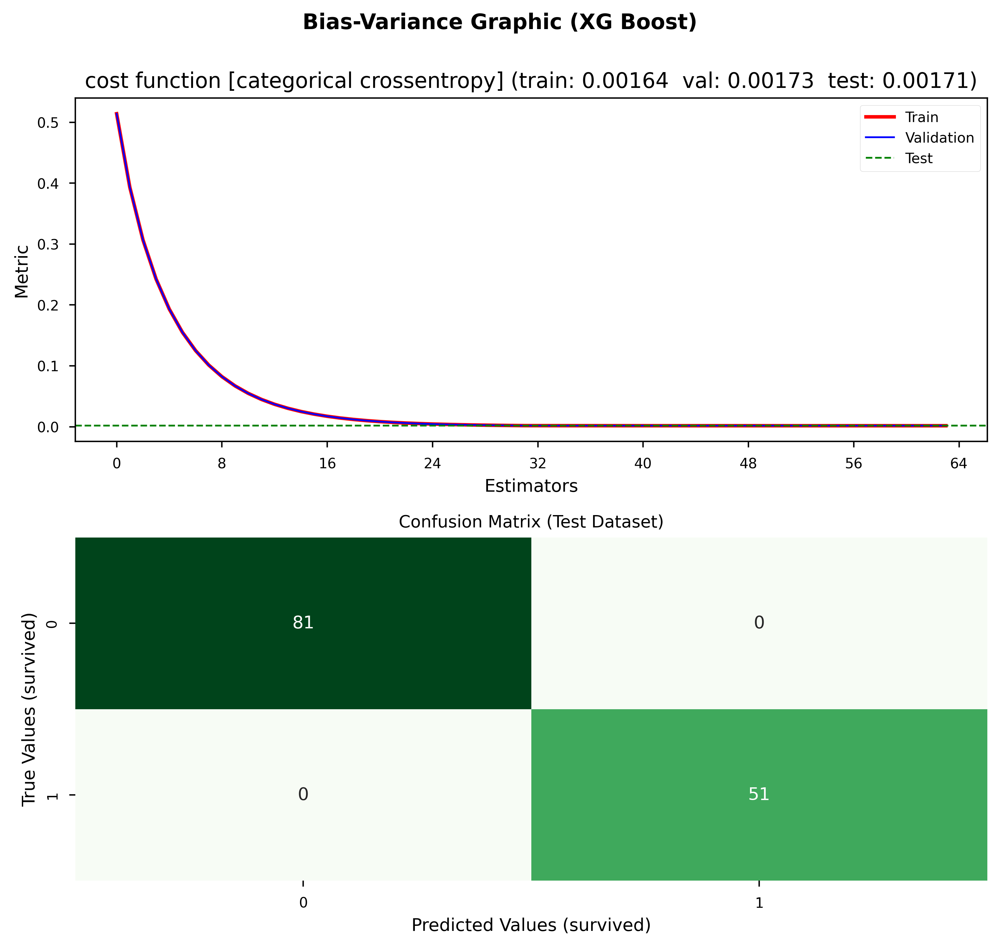

In [32]:
history_xgb_titanic = xgb_titanic.fit(return_history=True, graphic=True, graphic_save_extension='png', verbose=0)

In [33]:
pred_xgb_titanic = xgb_titanic.predict(sample_titanic)

Inference time: 14.01 milliseconds (10 register(s))


In [34]:
pred_xgb_titanic

,pclass,sex,sibsp,parch,fare,embarked,class,who,adult_male,embark_town,alive,alone,survived,survived (XGB prediction)
827,2,male,0,2,37.0042,C,Second,child,False,Cherbourg,yes,False,1,1
467,1,male,0,0,26.5500,S,First,man,True,Southampton,no,True,0,0
209,1,male,0,0,31.0000,C,First,man,True,Cherbourg,yes,True,1,1
466,2,male,0,0,0.0000,S,Second,man,True,Southampton,no,True,0,0
95,3,male,0,0,8.0500,S,Third,man,True,Southampton,no,True,0,0
762,3,male,0,0,7.2292,C,Third,man,True,Cherbourg,yes,True,1,1
528,3,male,0,0,7.9250,S,Third,man,True,Southampton,no,True,0,0
445,1,male,0,2,81.8583,S,First,child,False,Southampton,yes,False,1,1
511,3,male,0,0,8.0500,S,Third,man,True,Southampton,no,True,0,0
283,3,male,0,0,8.0500,S,Third,man,True,Southampton,yes,True,1,1


##### Salvar modelo treinado

In [35]:
xgb_titanic.save()

##### Recuperar modelo treinado

In [36]:
foldername_xgb_titanic = 'demo_xgb_titanic'

In [37]:
xgb_titanic_loaded = asapy.XgBoost(target="survived")

In [38]:
xgb_titanic_loaded.load(foldername_xgb_titanic)

In [39]:
pred_xgb_titanic_loaded = xgb_titanic_loaded.predict(sample_titanic)

Inference time: 14.40 milliseconds (10 register(s))


In [40]:
pred_xgb_titanic_loaded

,pclass,sex,sibsp,parch,fare,embarked,class,who,adult_male,embark_town,alive,alone,survived,survived (XGB prediction)
827,2,male,0,2,37.0042,C,Second,child,False,Cherbourg,yes,False,1,1
467,1,male,0,0,26.5500,S,First,man,True,Southampton,no,True,0,0
209,1,male,0,0,31.0000,C,First,man,True,Cherbourg,yes,True,1,1
466,2,male,0,0,0.0000,S,Second,man,True,Southampton,no,True,0,0
95,3,male,0,0,8.0500,S,Third,man,True,Southampton,no,True,0,0
762,3,male,0,0,7.2292,C,Third,man,True,Cherbourg,yes,True,1,1
528,3,male,0,0,7.9250,S,Third,man,True,Southampton,no,True,0,0
445,1,male,0,2,81.8583,S,First,child,False,Southampton,yes,False,1,1
511,3,male,0,0,8.0500,S,Third,man,True,Southampton,no,True,0,0
283,3,male,0,0,8.0500,S,Third,man,True,Southampton,yes,True,1,1


### Caso 2: [MNIST](https://www.kaggle.com/competitions/digit-recognizer)

In [213]:
from tensorflow.keras.datasets import mnist

In [220]:
(x_train, y_train), (x_test, y_test) = mnist.load_data()

x_train_reshaped = x_train.reshape(-1, x_train.shape[1] * x_train.shape[2])[:10_000]
x_test_reshaped = x_test.reshape(-1, x_train.shape[1] * x_train.shape[2])[:10_000]

df_mnist = pd.DataFrame(x_train_reshaped)
sample_mnist = pd.DataFrame(x_test_reshaped)

df_mnist['label'] = y_train[:10_000]
sample_mnist['label'] = y_test[:10_000]

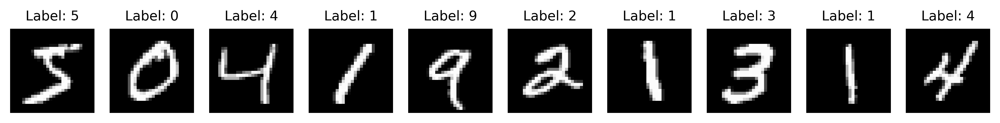

In [224]:
fig, axes = plt.subplots(1, 10, figsize=(10, 6))

for i, ax in enumerate(axes.flat):
    ax.imshow(df_mnist.iloc[i, :-1].values.reshape(28, 28), cmap='gray')
    ax.set_title(f"Label: {df_mnist.iloc[i, -1]}")    
    ax.axis('off')
    
plt.tight_layout()
plt.show()

#### Rede Neural

##### Uso Simples

In [225]:
nn_mnist = asapy.NeuralNetwork(target="label")

In [226]:
nn_mnist.build(df_mnist)

In [227]:
nn_mnist.hyperparameter_optimization()

In [228]:
nn_mnist.fit()

In [229]:
pred_nn_mnist = nn_mnist.predict(sample_mnist)

Inference time: 1173.17 milliseconds (10000 register(s))


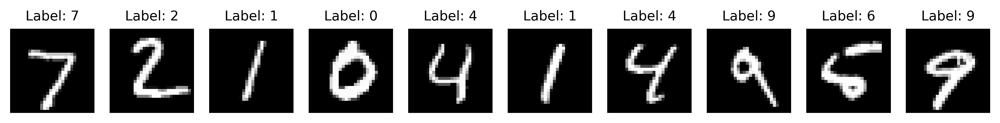

In [230]:
fig, axes = plt.subplots(1, 10, figsize=(10, 6))

for i, ax in enumerate(axes.flat):
    ax.imshow(pred_nn_mnist.iloc[i, :-2].values.reshape(28, 28), cmap='gray')
    ax.set_title(f"Label: {pred_nn_mnist.iloc[i, -1]}")    
    ax.axis('off')
    
plt.tight_layout()
plt.show()

##### Uso personalizado (uso de argumentos opcionais)

In [231]:
nn_mnist = asapy.NeuralNetwork(target="label", name='demo_nn_mnist', seed=25)

In [232]:
nn_mnist.build(
    df_mnist,
    task="classification",
    num_folds=5,
    max_cat_nunique = 10,
    split_size = (0.7, 0.15, 0.15),
    info=True,
    patience_early_stopping = 20,
    patience_reduceLR = 4,
    metrics=['auc', 'precision', 'recall', 'accuracy']
)


                Task: classification

                Total of registers: 10000
                Total of valid registers: 10000
                Total of invalid registers: 0

                Total of training registers: 6999
                Total of validation registers: 1501
                Total of test registers: 1500

                Features before preprocessing: 784
                Features after preprocessing: 784

                Numerical Features: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 1

In [233]:
nn_mnist.hyperparameter_optimization(
    n_trials=3,
    num_folds=5,
    info=True,
    search_space_dropout = [0, 0.05],
    search_space_layers = [3, 4],
    search_space_batch_size = [32],
    search_space_optimizer = ['Adam']
)

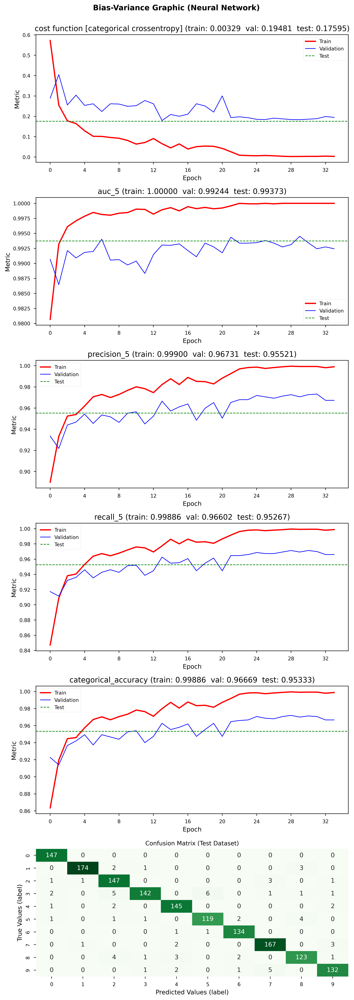

In [234]:
history_nn_mnist = nn_mnist.fit(return_history=True, graphic=True, graphic_save_extension='png', verbose=0)

In [235]:
pred_nn_mnist = nn_mnist.predict(sample_mnist, verbose=0)

Inference time: 1312.34 milliseconds (10000 register(s))


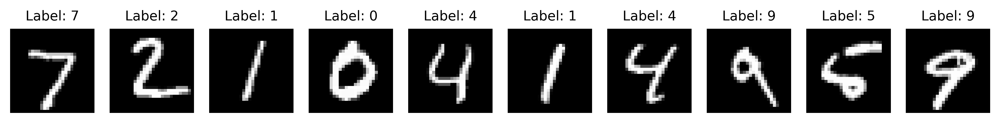

In [236]:
fig, axes = plt.subplots(1, 10, figsize=(10, 6))

for i, ax in enumerate(axes.flat):
    ax.imshow(pred_nn_mnist.iloc[i, :-2].values.reshape(28, 28), cmap='gray')
    ax.set_title(f"Label: {pred_nn_mnist.iloc[i, -1]}")    
    ax.axis('off')
    
plt.tight_layout()
plt.show()

##### Salvar modelo treinado

In [237]:
nn_mnist.save()

##### Recuperar modelo treinado

In [238]:
foldername_nn_mnist = 'demo_nn_mnist'

In [239]:
nn_mnist_loaded = asapy.NeuralNetwork(target="label")

In [240]:
nn_mnist_loaded.load(foldername_nn_mnist)

In [241]:
pred_nn_mnist_loaded = nn_mnist_loaded.predict(sample_mnist, verbose=0)

Inference time: 1396.99 milliseconds (10000 register(s))


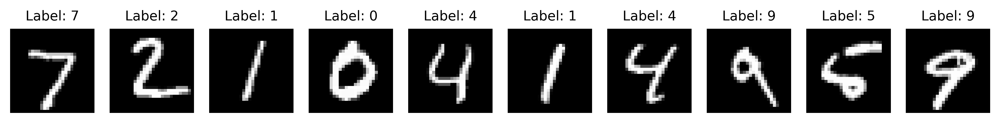

In [242]:
fig, axes = plt.subplots(1, 10, figsize=(10, 6))

for i, ax in enumerate(axes.flat):
    ax.imshow(pred_nn_mnist_loaded.iloc[i, :-2].values.reshape(28, 28), cmap='gray')
    ax.set_title(f"Label: {pred_nn_mnist_loaded.iloc[i, -1]}")    
    ax.axis('off')
    
plt.tight_layout()
plt.show()

#### XG Boost

##### Uso Simples

In [243]:
xgb_mnist = asapy.XgBoost(target="label")

In [244]:
xgb_mnist.build(df_mnist)

In [245]:
xgb_mnist.hyperparameter_optimization()

In [246]:
xgb_mnist.fit()

In [247]:
pred_xgb_mnist = xgb_mnist.predict(sample_mnist)

Inference time: 9040.73 milliseconds (10000 register(s))


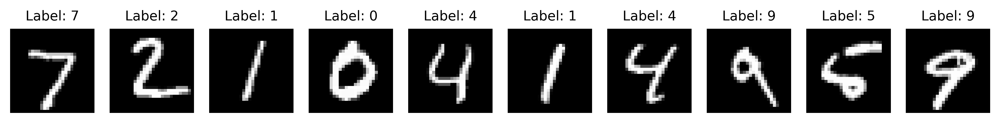

In [248]:
fig, axes = plt.subplots(1, 10, figsize=(10, 6))

for i, ax in enumerate(axes.flat):
    ax.imshow(pred_xgb_mnist.iloc[i, :-2].values.reshape(28, 28).astype(np.float64), cmap='gray') 
    ax.set_title(f"Label: {pred_xgb_mnist.iloc[i, -1]}")    
    ax.axis('off')
    
plt.tight_layout()
plt.show()

##### Uso personalizado (uso de argumentos opcionais)

In [249]:
xgb_mnist = asapy.XgBoost(target="label", name='demo_xgb_mnist', seed=25)

In [250]:
xgb_mnist.build(
    df_mnist,
    task='classification',
    num_folds=5,
    max_cat_nunique = 10,
    split_size = (0.7, 0.15, 0.15),
    info=True,
    patience_early_stopping = 20
)


                Task: classification

                Total of registers: 10000
                Total of valid registers: 10000
                Total of invalid registers: 0

                Total of training registers: 6999
                Total of validation registers: 1501
                Total of test registers: 1500

                Features before preprocessing: 784
                Features after preprocessing: 784

                Numerical Features: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 1

In [251]:
xgb_mnist.hyperparameter_optimization(
    n_trials=3,
    num_folds=5,
    info=True,
    search_space_tree_method = ['auto'],
    search_space_booster = ['gbtree', 'gblinear', 'dart'],
    search_space_learning_rate = [0.3],
    search_space_min_split_loss = [0],
    search_space_max_depth = [6],
    search_space_min_child_weight = [1],
    search_space_max_delta_step = [0],
    search_space_subsample = [1],
    search_space_sampling_method = ['uniform'],
    search_space_colsample_bytree = [1],
    search_space_colsample_bylevel = [1],
    search_space_colsample_bynode = [1],
    search_space_reg_lambda = [1],
    search_space_reg_alpha = [0],
    search_space_scale_pos_weight = [1],
    search_space_grow_policy = ['depthwise'],
    search_space_max_leaves = [0],
    search_space_max_bin = [256],
    search_space_num_parallel_tree = [1]
)

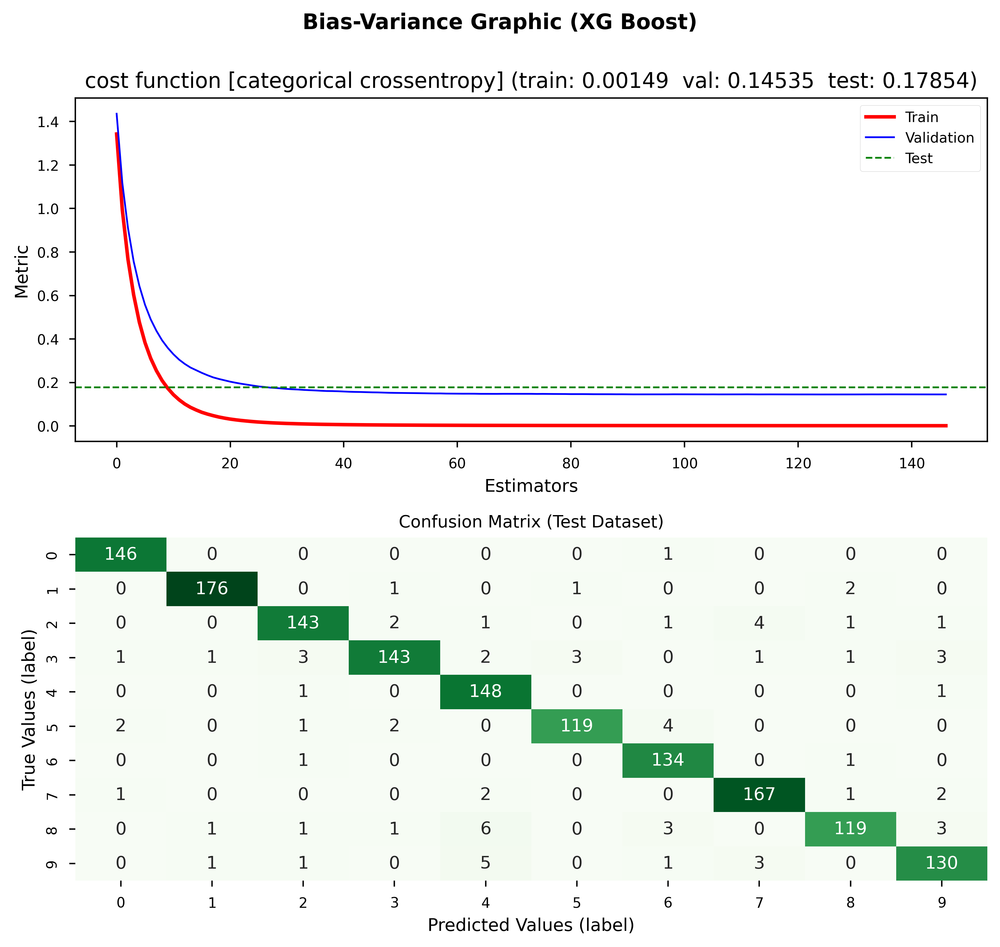

In [252]:
history_xgb_mnist = xgb_mnist.fit(return_history=True, graphic=True, graphic_save_extension='png', verbose=0)

In [253]:
pred_xgb_mnist = xgb_mnist.predict(sample_mnist)

Inference time: 14397.13 milliseconds (10000 register(s))


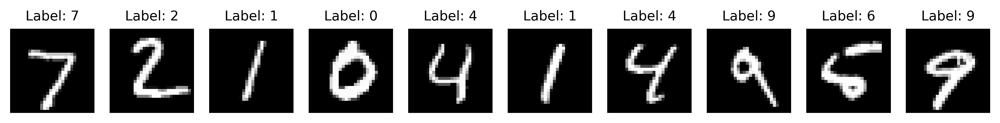

In [254]:
fig, axes = plt.subplots(1, 10, figsize=(10, 6))

for i, ax in enumerate(axes.flat):
    ax.imshow(pred_xgb_mnist.iloc[i, :-2].values.reshape(28, 28).astype(np.float64), cmap='gray')
    ax.set_title(f"Label: {pred_xgb_mnist.iloc[i, -1]}")    
    ax.axis('off')
    
plt.tight_layout()
plt.show()

##### Salvar modelo treinado

In [255]:
xgb_mnist.save()

##### Recuperar modelo treinado

In [256]:
foldername_xgb_mnist = 'demo_xgb_mnist'

In [257]:
xgb_mnist_loaded = asapy.XgBoost(target="label")

In [258]:
xgb_mnist_loaded.load(foldername_xgb_mnist)

In [259]:
pred_xgb_mnist_loaded = xgb_mnist_loaded.predict(sample_mnist)

Inference time: 13829.54 milliseconds (10000 register(s))


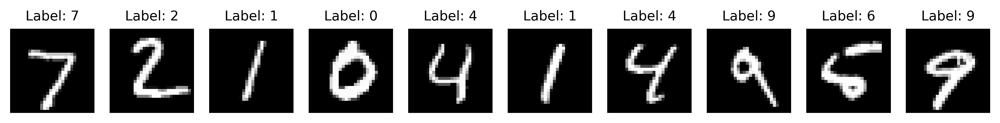

In [260]:
fig, axes = plt.subplots(1, 10, figsize=(10, 6))

for i, ax in enumerate(axes.flat):
    ax.imshow(pred_xgb_mnist_loaded.iloc[i, :-2].values.reshape(28, 28).astype(np.float64), cmap='gray')
    ax.set_title(f"Label: {pred_xgb_mnist_loaded.iloc[i, -1]}")    
    ax.axis('off')
    
plt.tight_layout()
plt.show()

## Regressão

### Caso 3: [California housing](https://www.kaggle.com/datasets/camnugent/california-housing-prices)

In [41]:
housing = datasets.fetch_california_housing()

In [42]:
df_house = pd.DataFrame(housing.data, columns=housing.feature_names)
df_house['MedHouseVal'] = housing.target

In [43]:
sample_house = df_house.sample(10)
df_house.drop(sample_house.index, inplace=True)

In [44]:
df_house.head(5)

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422


#### Rede Neural

##### Uso Simples

In [45]:
nn_house = asapy.NeuralNetwork(target="MedHouseVal")

In [46]:
nn_house.build(df_house)

In [47]:
nn_house.hyperparameter_optimization()

In [48]:
nn_house.fit()

In [49]:
pred_nn_house = nn_house.predict(sample_house)

Inference time: 89.85 milliseconds (10 register(s))


In [50]:
pred_nn_house

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal,MedHouseVal (NN prediction)
2322,3.5078,15.0,6.254587,1.146789,1228.0,2.816514,36.83,-119.71,1.09000,1.469543
980,4.9879,28.0,6.517986,1.057554,853.0,3.068345,37.67,-121.87,2.29400,2.503232
17408,1.8185,23.0,4.026786,1.026786,1322.0,3.934524,34.97,-120.54,0.97800,1.834034
9094,3.3173,18.0,5.645373,1.123669,2837.0,2.323505,34.65,-118.29,2.18400,1.471593
3775,4.1875,14.0,4.438462,1.153846,372.0,2.861538,34.16,-118.41,2.75000,1.945160
16032,4.4750,47.0,5.628571,1.095238,1083.0,3.438095,37.72,-122.45,2.21200,2.911655
13046,2.2330,25.0,4.746988,1.132530,155.0,1.867470,38.58,-121.22,0.55000,1.384191
11447,2.8061,14.0,4.879808,1.072115,1974.0,1.581731,33.66,-117.97,1.80300,1.732682
10794,5.9196,27.0,8.852217,1.689655,435.0,2.142857,33.61,-117.91,5.00001,3.374063
11419,6.0910,20.0,7.229167,1.020833,1319.0,3.053241,33.69,-117.96,2.90400,2.832232


##### Uso personalizado (uso de argumentos opcionais)

In [51]:
nn_house = asapy.NeuralNetwork(target="MedHouseVal", name='demo_nn_house', seed=25)

In [52]:
nn_house.build(
    df_house,
    task="regression",
    max_cat_nunique = 10,
    split_size = (0.7, 0.15, 0.15),
    info=True,
    patience_early_stopping = 20,
    patience_reduceLR = 4,
    metrics=['mse', 'rmse', 'msle', 'mae', 'mape']
)


                Task: regression

                Total of registers: 20630
                Total of valid registers: 20630
                Total of invalid registers: 0

                Total of training registers: 14440
                Total of validation registers: 3095
                Total of test registers: 3095

                Features before preprocessing: 8
                Features after preprocessing: 8

                Numerical Features: ['MedInc', 'HouseAge', 'AveRooms', 'AveBedrms', 'Population', 'AveOccup', 'Latitude', 'Longitude']
                Categorical Features: []
                Categorical Features removed due to high cardinality: []

                Target: ['MedHouseVal']
            


In [53]:
nn_house.hyperparameter_optimization(
    n_trials=5,
    num_folds=5,
    info=True,
    search_space_dropout = [0.0, 0.5],
    search_space_layers = [3, 4],
    search_space_batch_size = [32, 64],
    search_space_optimizer = ['Adam']
)

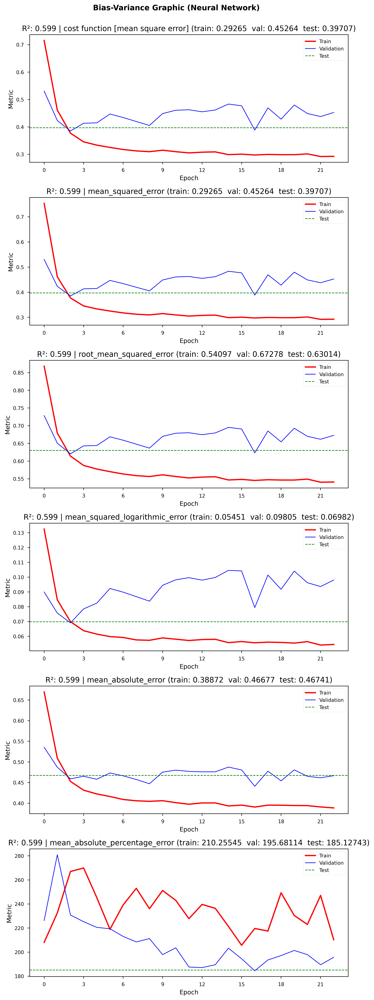

In [54]:
history_nn_house = nn_house.fit(return_history=True, graphic=True, graphic_save_extension='png', verbose=0)

In [55]:
pred_nn_house = nn_house.predict(sample_house, verbose=0)

Inference time: 48.47 milliseconds (10 register(s))


In [56]:
pred_nn_house

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal,MedHouseVal (NN prediction)
2322,3.5078,15.0,6.254587,1.146789,1228.0,2.816514,36.83,-119.71,1.09000,1.464833
980,4.9879,28.0,6.517986,1.057554,853.0,3.068345,37.67,-121.87,2.29400,2.470377
17408,1.8185,23.0,4.026786,1.026786,1322.0,3.934524,34.97,-120.54,0.97800,1.469529
9094,3.3173,18.0,5.645373,1.123669,2837.0,2.323505,34.65,-118.29,2.18400,1.433979
3775,4.1875,14.0,4.438462,1.153846,372.0,2.861538,34.16,-118.41,2.75000,2.534612
16032,4.4750,47.0,5.628571,1.095238,1083.0,3.438095,37.72,-122.45,2.21200,3.239797
13046,2.2330,25.0,4.746988,1.132530,155.0,1.867470,38.58,-121.22,0.55000,1.285808
11447,2.8061,14.0,4.879808,1.072115,1974.0,1.581731,33.66,-117.97,1.80300,1.459605
10794,5.9196,27.0,8.852217,1.689655,435.0,2.142857,33.61,-117.91,5.00001,2.696598
11419,6.0910,20.0,7.229167,1.020833,1319.0,3.053241,33.69,-117.96,2.90400,2.751924


##### Salvar modelo treinado

In [57]:
nn_house.save()

##### Recuperar modelo treinado

In [58]:
foldername_nn_house = 'demo_nn_house'

In [59]:
nn_house_loaded = asapy.NeuralNetwork(target="MedHouseVal")

In [60]:
nn_house_loaded.load(foldername_nn_house)

In [61]:
pred_nn_house_loaded = nn_house_loaded.predict(sample_house, verbose=0)

Inference time: 100.04 milliseconds (10 register(s))


In [62]:
pred_nn_house_loaded

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal,MedHouseVal (NN prediction)
2322,3.5078,15.0,6.254587,1.146789,1228.0,2.816514,36.83,-119.71,1.09000,1.464833
980,4.9879,28.0,6.517986,1.057554,853.0,3.068345,37.67,-121.87,2.29400,2.470377
17408,1.8185,23.0,4.026786,1.026786,1322.0,3.934524,34.97,-120.54,0.97800,1.469529
9094,3.3173,18.0,5.645373,1.123669,2837.0,2.323505,34.65,-118.29,2.18400,1.433979
3775,4.1875,14.0,4.438462,1.153846,372.0,2.861538,34.16,-118.41,2.75000,2.534612
16032,4.4750,47.0,5.628571,1.095238,1083.0,3.438095,37.72,-122.45,2.21200,3.239797
13046,2.2330,25.0,4.746988,1.132530,155.0,1.867470,38.58,-121.22,0.55000,1.285808
11447,2.8061,14.0,4.879808,1.072115,1974.0,1.581731,33.66,-117.97,1.80300,1.459605
10794,5.9196,27.0,8.852217,1.689655,435.0,2.142857,33.61,-117.91,5.00001,2.696598
11419,6.0910,20.0,7.229167,1.020833,1319.0,3.053241,33.69,-117.96,2.90400,2.751924


#### XG Boost

##### Uso Simples

In [63]:
xgb_house = asapy.XgBoost(target="MedHouseVal")

In [64]:
xgb_house.build(df_house)

In [65]:
xgb_house.hyperparameter_optimization()

In [66]:
xgb_house.fit()

In [67]:
pred_xgb_house = xgb_house.predict(sample_house)

Inference time: 7.14 milliseconds (10 register(s))


In [68]:
pred_xgb_house

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal,MedHouseVal (XGB prediction)
2322,3.5078,15.0,6.254587,1.146789,1228.0,2.816514,36.83,-119.71,1.09000,1.096230
980,4.9879,28.0,6.517986,1.057554,853.0,3.068345,37.67,-121.87,2.29400,2.196412
17408,1.8185,23.0,4.026786,1.026786,1322.0,3.934524,34.97,-120.54,0.97800,0.884922
9094,3.3173,18.0,5.645373,1.123669,2837.0,2.323505,34.65,-118.29,2.18400,1.443272
3775,4.1875,14.0,4.438462,1.153846,372.0,2.861538,34.16,-118.41,2.75000,2.472747
16032,4.4750,47.0,5.628571,1.095238,1083.0,3.438095,37.72,-122.45,2.21200,2.490612
13046,2.2330,25.0,4.746988,1.132530,155.0,1.867470,38.58,-121.22,0.55000,1.411207
11447,2.8061,14.0,4.879808,1.072115,1974.0,1.581731,33.66,-117.97,1.80300,2.070059
10794,5.9196,27.0,8.852217,1.689655,435.0,2.142857,33.61,-117.91,5.00001,5.059376
11419,6.0910,20.0,7.229167,1.020833,1319.0,3.053241,33.69,-117.96,2.90400,2.894094


##### Uso Avançado (uso de argumentos opcionais)

In [69]:
xgb_house = asapy.XgBoost(target="MedHouseVal", name='demo_xgb_house', seed=25)

In [70]:
xgb_house.build(
    df_house,
    task="regression",
    max_cat_nunique = 10,
    split_size = (0.7, 0.15, 0.15),
    info=True,
    patience_early_stopping = 20
)


                Task: regression

                Total of registers: 20630
                Total of valid registers: 20630
                Total of invalid registers: 0

                Total of training registers: 14440
                Total of validation registers: 3095
                Total of test registers: 3095

                Features before preprocessing: 8
                Features after preprocessing: 8

                Numerical Features: ['MedInc', 'HouseAge', 'AveRooms', 'AveBedrms', 'Population', 'AveOccup', 'Latitude', 'Longitude']
                Categorical Features: []
                Categorical Features removed due to high cardinality: []

                Target: ['MedHouseVal']
            


In [71]:
xgb_house.hyperparameter_optimization(
    n_trials=5,
    num_folds = 5, 
    info=True,
    search_space_tree_method = ['auto'],
    search_space_booster = ['gbtree', 'gblinear', 'dart'],
    search_space_learning_rate = [0.1, 0.3],
    search_space_min_split_loss = [0],
    search_space_max_depth = [6],
    search_space_min_child_weight = [1],
    search_space_max_delta_step = [0],
    search_space_subsample = [1],
    search_space_sampling_method = ['uniform'],
    search_space_colsample_bytree = [1],
    search_space_colsample_bylevel = [1],
    search_space_colsample_bynode = [1],
    search_space_reg_lambda = [1],
    search_space_reg_alpha = [0],
    search_space_scale_pos_weight = [1],
    search_space_grow_policy = ['depthwise', 'lossguide'],
    search_space_max_leaves = [0],
    search_space_max_bin = [256, 512],
    search_space_num_parallel_tree = [1]
)

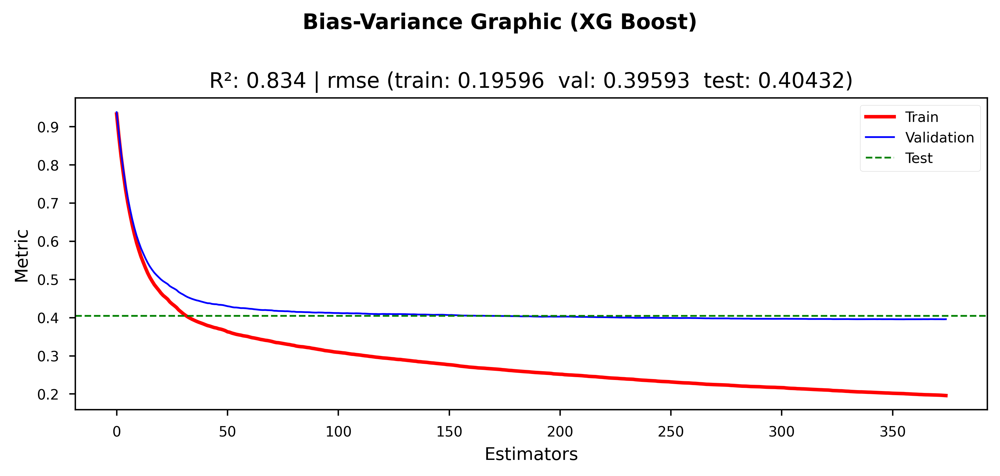

In [72]:
history_xgb_house = xgb_house.fit(return_history=True, graphic=True, graphic_save_extension='png', verbose=0)

In [73]:
pred_xgb_house = xgb_house.predict(sample_house)

Inference time: 9.16 milliseconds (10 register(s))


In [74]:
pred_xgb_house

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal,MedHouseVal (XGB prediction)
2322,3.5078,15.0,6.254587,1.146789,1228.0,2.816514,36.83,-119.71,1.09000,0.961298
980,4.9879,28.0,6.517986,1.057554,853.0,3.068345,37.67,-121.87,2.29400,2.238892
17408,1.8185,23.0,4.026786,1.026786,1322.0,3.934524,34.97,-120.54,0.97800,1.079459
9094,3.3173,18.0,5.645373,1.123669,2837.0,2.323505,34.65,-118.29,2.18400,1.319570
3775,4.1875,14.0,4.438462,1.153846,372.0,2.861538,34.16,-118.41,2.75000,2.470077
16032,4.4750,47.0,5.628571,1.095238,1083.0,3.438095,37.72,-122.45,2.21200,2.709900
13046,2.2330,25.0,4.746988,1.132530,155.0,1.867470,38.58,-121.22,0.55000,1.637520
11447,2.8061,14.0,4.879808,1.072115,1974.0,1.581731,33.66,-117.97,1.80300,1.935594
10794,5.9196,27.0,8.852217,1.689655,435.0,2.142857,33.61,-117.91,5.00001,4.626432
11419,6.0910,20.0,7.229167,1.020833,1319.0,3.053241,33.69,-117.96,2.90400,2.898663


##### Salvar modelo treinado

In [75]:
xgb_house.save()

##### Recuperar modelo treinado

In [76]:
foldername_xgb_house = 'demo_xgb_house'

In [77]:
xgb_house_loaded = asapy.XgBoost(target="MedHouseVal")

In [78]:
xgb_house_loaded.load(foldername_xgb_house)

In [79]:
pred_xgb_house_loaded = xgb_house_loaded.predict(sample_house)

Inference time: 7.75 milliseconds (10 register(s))


In [80]:
pred_xgb_house_loaded

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal,MedHouseVal (XGB prediction)
2322,3.5078,15.0,6.254587,1.146789,1228.0,2.816514,36.83,-119.71,1.09000,0.961298
980,4.9879,28.0,6.517986,1.057554,853.0,3.068345,37.67,-121.87,2.29400,2.238892
17408,1.8185,23.0,4.026786,1.026786,1322.0,3.934524,34.97,-120.54,0.97800,1.079459
9094,3.3173,18.0,5.645373,1.123669,2837.0,2.323505,34.65,-118.29,2.18400,1.319570
3775,4.1875,14.0,4.438462,1.153846,372.0,2.861538,34.16,-118.41,2.75000,2.470077
16032,4.4750,47.0,5.628571,1.095238,1083.0,3.438095,37.72,-122.45,2.21200,2.709900
13046,2.2330,25.0,4.746988,1.132530,155.0,1.867470,38.58,-121.22,0.55000,1.637520
11447,2.8061,14.0,4.879808,1.072115,1974.0,1.581731,33.66,-117.97,1.80300,1.935594
10794,5.9196,27.0,8.852217,1.689655,435.0,2.142857,33.61,-117.91,5.00001,4.626432
11419,6.0910,20.0,7.229167,1.020833,1319.0,3.053241,33.69,-117.96,2.90400,2.898663


# Aprendizado Não Supervisionado

### Caso 4: Dispersão Bidimensional de Pontos

In [81]:
X_moons, _ = datasets.make_moons(n_samples=300, noise=0.1, random_state=0)
df_moons = pd.DataFrame(X_moons, columns=['Feature 1', 'Feature 2'])

In [82]:
X_circles, _ = datasets.make_circles(n_samples=300, factor=0.5, noise=0.05, random_state=0)
df_circles = pd.DataFrame(X_circles, columns=['Feature 1', 'Feature 2'])

In [83]:
X_blobs, _ = datasets.make_blobs(n_samples=300, centers=[[-1, -1], [1, 1]], cluster_std=0.5, random_state=0)
df_blobs = pd.DataFrame(X_blobs, columns=['Feature 1', 'Feature 2'])

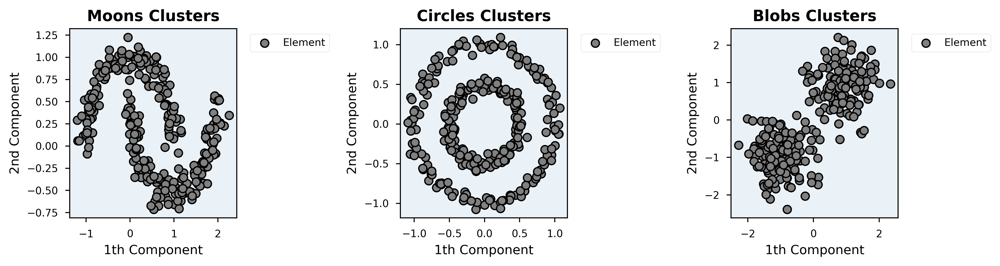

In [84]:
fig = plt.figure(figsize=(11, 3))

titles = ['Moons Clusters', 'Circles Clusters', 'Blobs Clusters']

_datasets = [X_moons, X_circles, X_blobs]

for i, (title, dataset) in enumerate(zip(titles, _datasets), start=1):
    ax = fig.add_subplot(1, 3, i)
    ax.set_facecolor('#EAF2F8')
    ax.set_title(title, fontweight='bold', fontsize=12)
    ax.scatter(dataset[:, 0], dataset[:, 1], edgecolor='k', color='gray', s=40, linewidths=1, marker='o', label='Element')
    ax.set_xlabel('1th Component', fontsize=10)
    ax.set_ylabel('2nd Component', fontsize=10)
    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1), frameon=True, framealpha=0.9, facecolor='white')

plt.tight_layout()
plt.show()
plt.close()

#### DBSCAN

##### Uso Simples

###### Dataset Moons

In [85]:
dbscan_moons = asapy.DBSCAN()

In [86]:
dbscan_moons.build(df_moons)

In [87]:
dbscan_moons.hyperparameter_optimization()

In [88]:
dbscan_moons.fit()

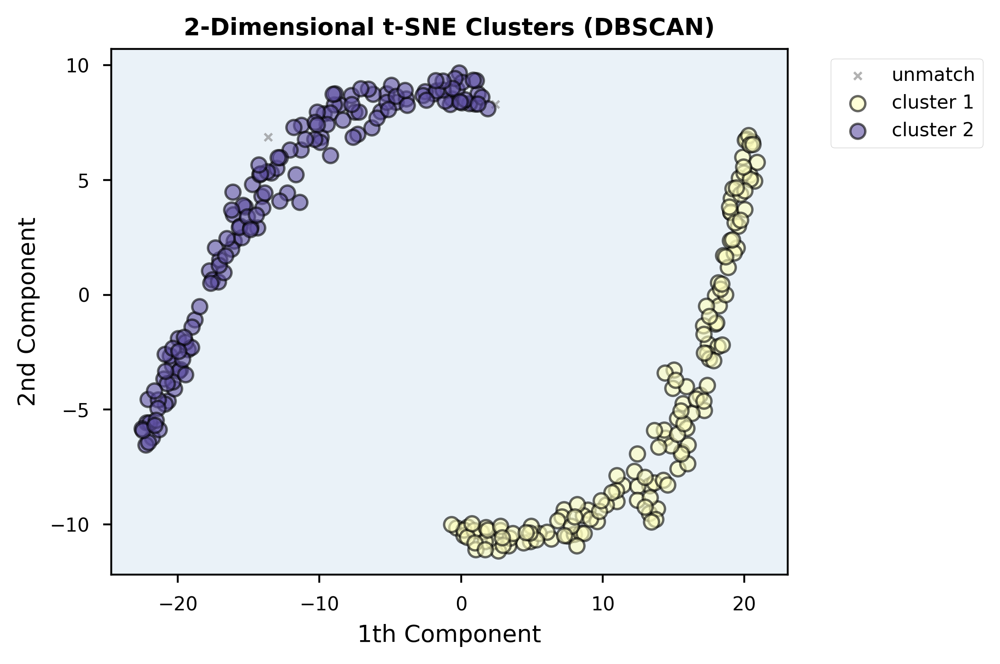

In [89]:
dbscan_moons.predict()

###### Dataset Circles

In [90]:
dbscan_circles = asapy.DBSCAN()

In [91]:
dbscan_circles.build(df_circles)

In [92]:
dbscan_circles.hyperparameter_optimization()

In [93]:
dbscan_circles.fit()

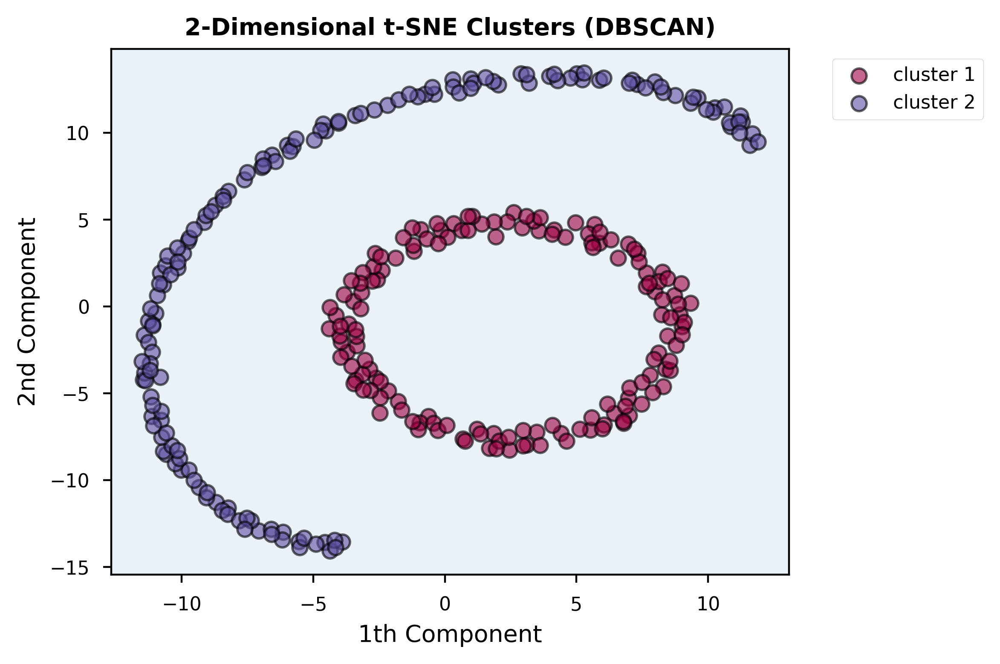

In [94]:
dbscan_circles.predict()

###### Dataset Blobs

In [95]:
dbscan_blobs = asapy.DBSCAN()

In [96]:
dbscan_blobs.build(df_blobs)

In [97]:
dbscan_blobs.hyperparameter_optimization()

In [98]:
dbscan_blobs.fit()

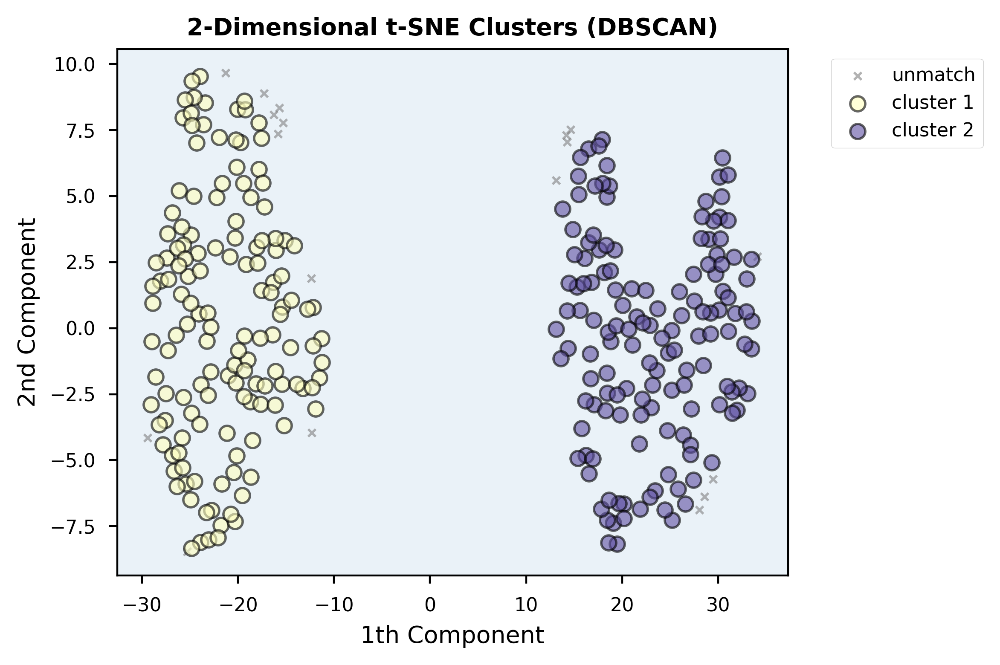

In [99]:
dbscan_blobs.predict()

##### Uso personalizado (uso de argumentos opcionais)

###### Dataset Moons

In [100]:
dbscan_moons = asapy.DBSCAN(name='demo_dbscan_moons', seed=25)

In [101]:
dbscan_moons.build(df_moons, info=True)


                Total of registers: 300
                Total of valid registers: 300
                Total of invalid registers: 0

                Total of Features: 2
                Numerical Features: ['Feature 1', 'Feature 2']
                Categorical Features: []
                Categorical Features removed due to high cardinality: []
            


In [102]:
dbscan_moons.hyperparameter_optimization(
    n_trials=100,
    info=True,
    search_space_eps = [0.1, 0.3, 0.4, 0.5, 0.6, 0.7, 1],
    search_space_min_samples = [3, 4, 5, 6, 7],
    search_space_algorithm = ['auto'],
    search_space_leaf_size = [10, 20, 30, 40, 50],
    search_space_p = [2]
)

,Trial (nº),Silhouette Score,params_algorithm,params_eps,params_leaf_size,params_min_samples,params_p
Ranking,,,,,,,
1º,99,0.255727,auto,0.3,10,6,2
2º,54,0.255727,auto,0.3,40,6,2
3º,77,0.255727,auto,0.3,10,6,2
4º,76,0.255727,auto,0.3,40,6,2
5º,31,0.255727,auto,0.3,10,6,2
...,...,...,...,...,...,...,...
96º,35,-1.000000,auto,0.5,10,3,2
97º,34,-1.000000,auto,0.7,40,6,2
98º,74,-1.000000,auto,0.5,10,6,2


In [103]:
dbscan_moons.fit()

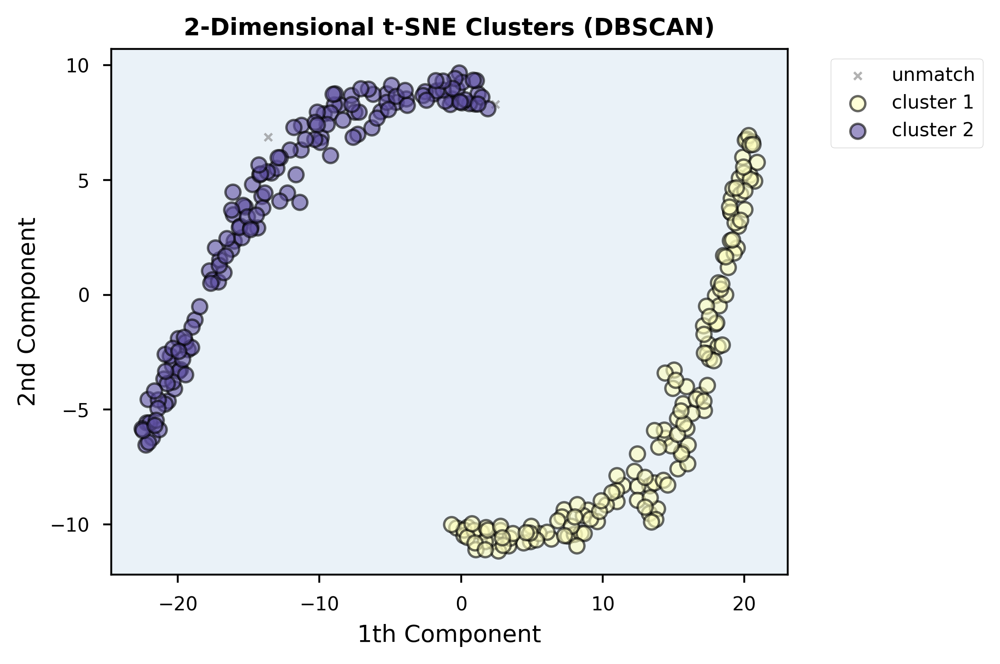

In [104]:
dbscan_moons.predict(projection='2d', graphic_save_extension='png')

##### Salvar modelo treinado

In [105]:
dbscan_moons.save()

##### Recuperar modelo treinado

In [106]:
foldername_dbscan_moons = 'demo_dbscan_moons'

In [107]:
dbscan_moons_loaded = asapy.DBSCAN()

In [108]:
dbscan_moons_loaded.load(foldername_dbscan_moons)

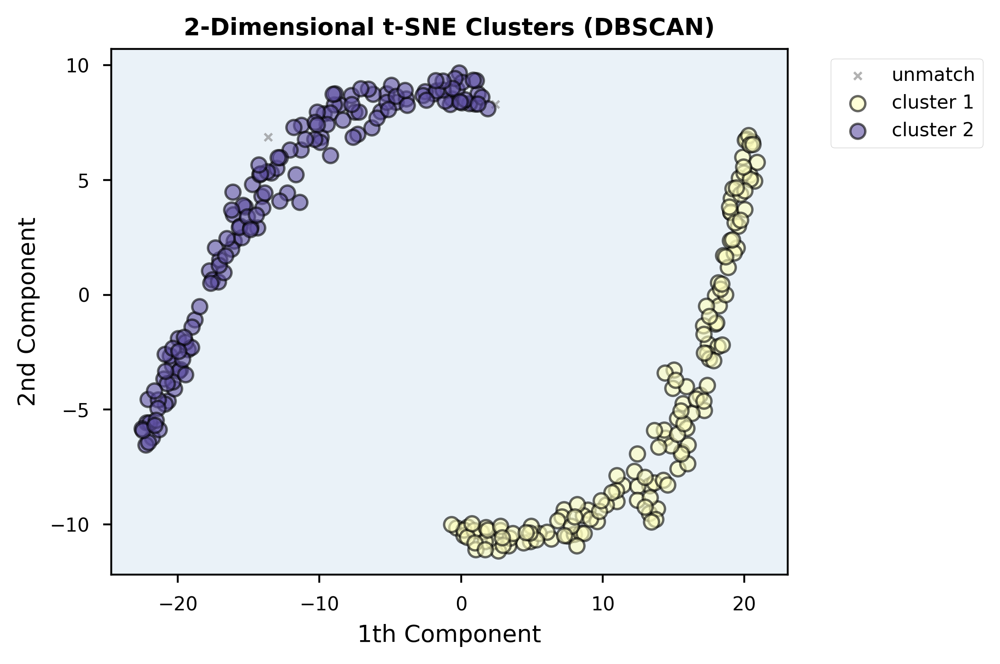

In [109]:
dbscan_moons_loaded.predict()

#### K-Means

##### Uso Simples

###### Dataset Moons

In [110]:
kmeans_moons = asapy.KMeans()

In [111]:
kmeans_moons.build(df_moons)

In [112]:
kmeans_moons.hyperparameter_optimization(search_space_n_clusters=[2])

In [113]:
kmeans_moons.fit()

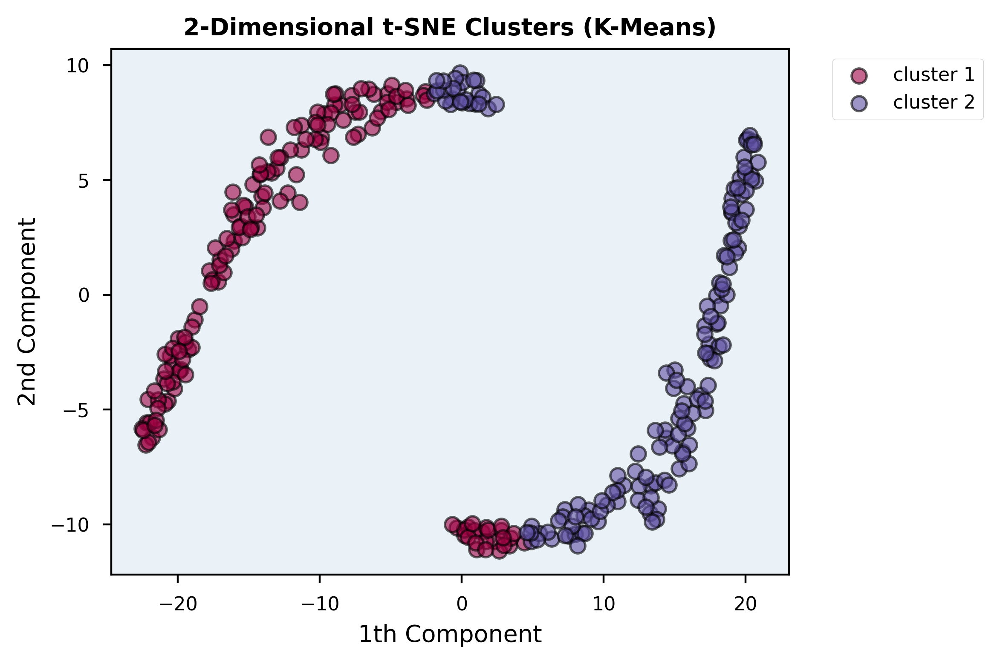

In [114]:
kmeans_moons.predict()

###### Dataset Circles

In [115]:
kmeans_circles = asapy.KMeans()

In [116]:
kmeans_circles.build(df_circles)

In [117]:
kmeans_circles.hyperparameter_optimization(search_space_n_clusters=[2])

In [118]:
kmeans_circles.fit()

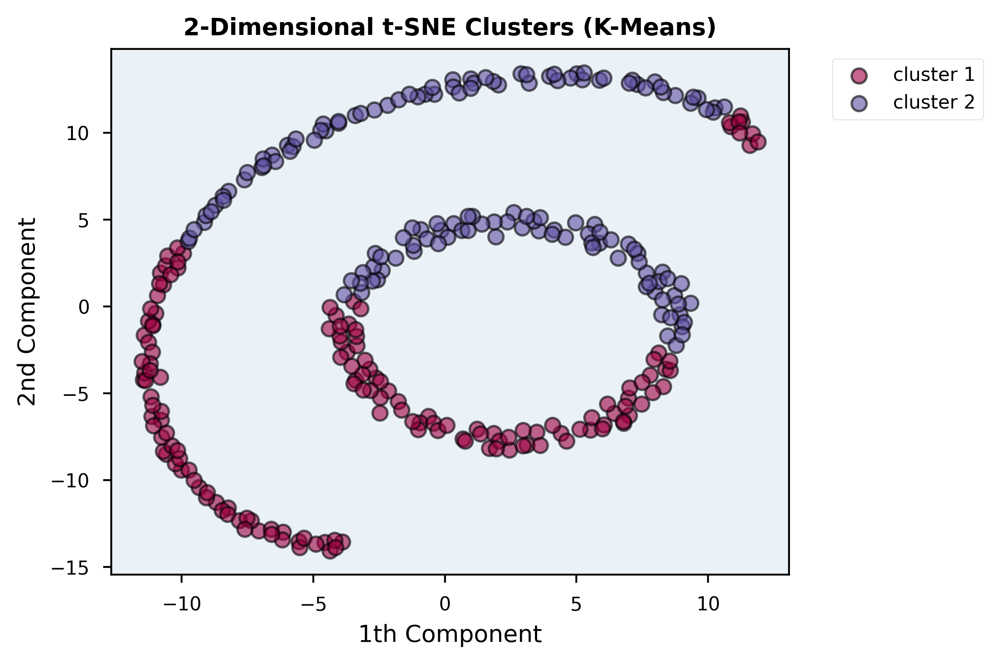

In [119]:
kmeans_circles.predict()

###### Dataset Blobs

In [120]:
kmeans_blobs = asapy.KMeans()

In [121]:
kmeans_blobs.build(df_blobs)

In [122]:
kmeans_blobs.hyperparameter_optimization(search_space_n_clusters=[2])

In [123]:
kmeans_blobs.fit()

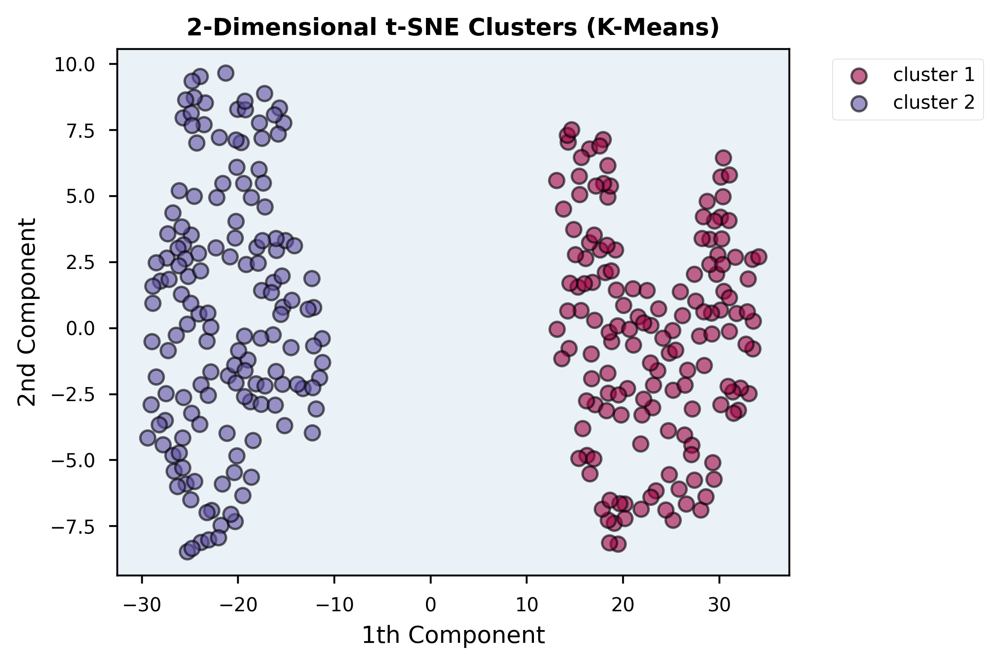

In [124]:
kmeans_blobs.predict()

##### Uso personalizado (uso de argumentos opcionais)

In [125]:
kmeans_blobs = asapy.KMeans(name='demo_kmeans_blobs', seed=25)

In [126]:
kmeans_blobs.build(df_blobs, info=True)


                Total of registers: 300
                Total of valid registers: 300
                Total of invalid registers: 0

                Total of Features: 2
                Numerical Features: ['Feature 1', 'Feature 2']
                Categorical Features: []
                Categorical Features removed due to high cardinality: []
            


In [127]:
kmeans_blobs.hyperparameter_optimization(
    n_trials=10,
    info=True,
    search_space_n_clusters=[2],
    search_space_init  = ['k-means++'],
    search_space_n_init = ['auto'],
    search_space_tol = [1e-5, 1e-4, 1e-3],
    search_space_algorithm = ['lloyd', 'elkan']
)

,Trial (nº),Silhouette Score,params_algorithm,params_init,params_n_clusters,params_n_init,params_tol
Ranking,,,,,,,
1º,0,0.670796,elkan,k-means++,2,auto,0.00010
2º,1,0.670796,lloyd,k-means++,2,auto,0.00010
3º,2,0.670796,elkan,k-means++,2,auto,0.00010
4º,3,0.670796,lloyd,k-means++,2,auto,0.00100
5º,4,0.670796,lloyd,k-means++,2,auto,0.00010
6º,5,0.670796,elkan,k-means++,2,auto,0.00100
7º,6,0.670796,elkan,k-means++,2,auto,0.00010
8º,7,0.670796,elkan,k-means++,2,auto,0.00001
9º,8,0.670796,elkan,k-means++,2,auto,0.00100


In [128]:
clusters = kmeans_blobs.fit(return_cluster=True, verbose=0)

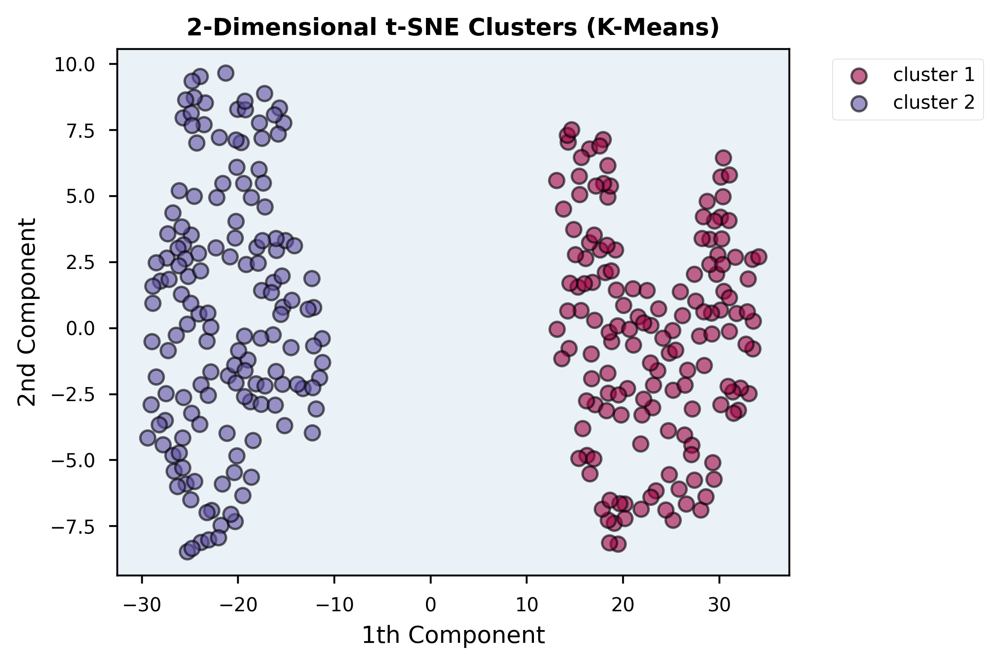

In [129]:
kmeans_blobs.predict(projection='2d', graphic_save_extension='png')

##### Salvar modelo treinado

In [130]:
kmeans_blobs.save()

##### Recuperar modelo treinado

In [131]:
foldername_kmeans_blobs = 'demo_kmeans_blobs'

In [132]:
kmeans_blobs_loaded = asapy.KMeans()

In [133]:
kmeans_blobs_loaded.load(foldername_kmeans_blobs)

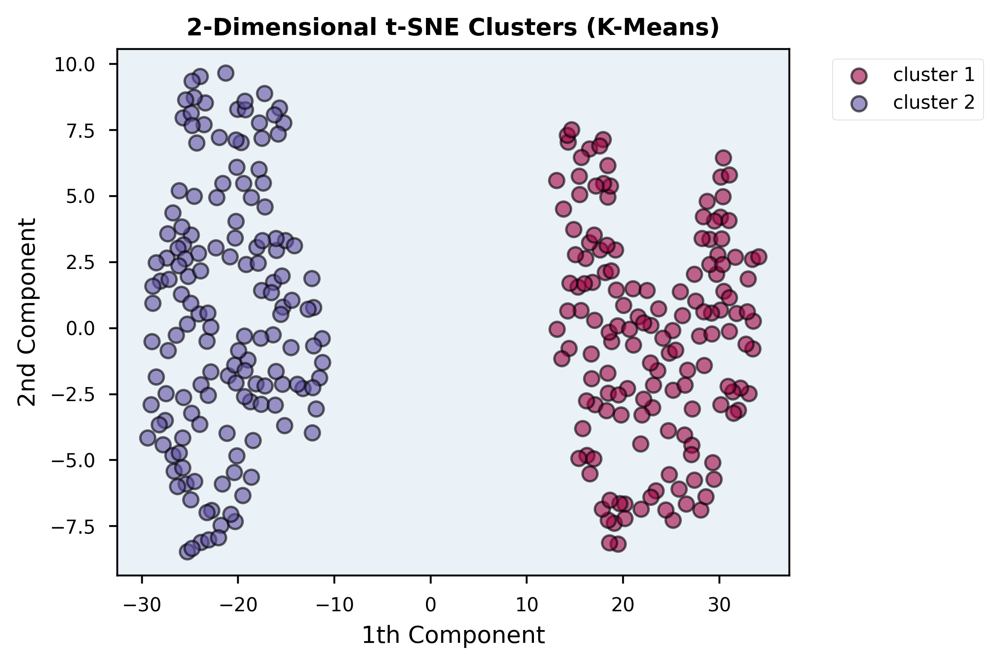

In [134]:
kmeans_blobs_loaded.predict()

### Caso 5: [Iris Species](https://www.kaggle.com/datasets/uciml/iris)

In [135]:
iris = datasets.load_iris()
df_iris = pd.DataFrame(iris.data, columns=iris.feature_names)
target = iris.target

In [136]:
scaler = StandardScaler()
df_iris_scaled = scaler.fit_transform(df_iris)

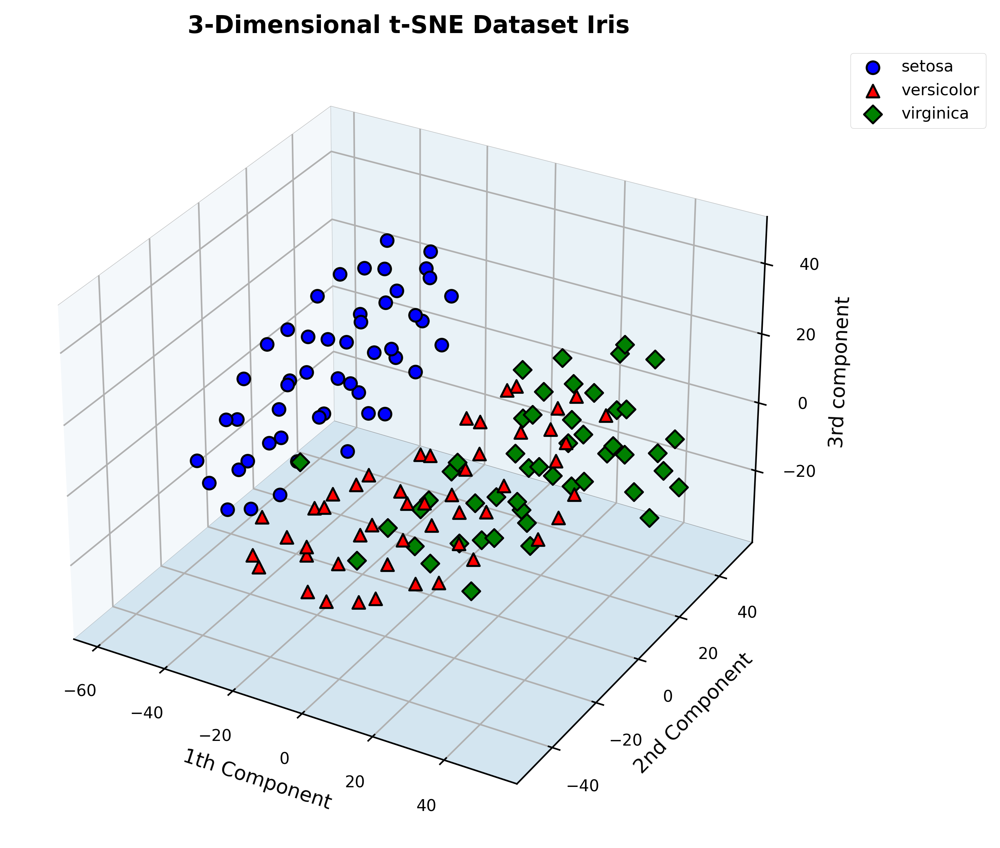

In [137]:
fig = plt.figure(figsize=(8, 6))

tsne = TSNE(n_components=3)
X_reduced = tsne.fit_transform(df_iris_scaled)

markers = ['o', '^', 'D']
colors = ['blue', 'red', 'green']

ax = fig.add_subplot(111, projection='3d')
ax.set_title('3-Dimensional t-SNE Dataset Iris', fontweight='bold', fontsize=12)
ax.set_zlabel('3rd component', fontsize=10)

for i in np.unique(iris.target):

    ax.scatter(
        X_reduced[target == i, 0],
        X_reduced[target == i, 1],
        X_reduced[target == i, 2],
        edgecolor='k',
        color=colors[i],
        s=40,
        # alpha=0.6,
        linewidths=1,
        depthshade=False,
        marker=markers[i],
        label=iris.target_names[i]
    )

ax.xaxis.pane.set_edgecolor('gray')
ax.yaxis.pane.set_edgecolor('gray')
ax.zaxis.pane.set_edgecolor('gray')
ax.xaxis.pane.fill = True
ax.yaxis.pane.fill = True
ax.zaxis.pane.fill = True
ax.xaxis.pane.set_facecolor('#EAF2F8')
ax.yaxis.pane.set_facecolor('#D4E6F1')
ax.zaxis.pane.set_facecolor('#A9CCE3')

ax.set_xlabel('1th Component', fontsize=10)
ax.set_ylabel('2nd Component', fontsize=10)

ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1), frameon=True, framealpha=0.9, facecolor='white')

ax.grid(True)

plt.tight_layout()
plt.show()
plt.close()

#### DBSCAN

##### Uso Simples

In [138]:
dbscan_iris = asapy.DBSCAN()

In [139]:
dbscan_iris.build(df_iris)

In [140]:
dbscan_iris.hyperparameter_optimization()

In [141]:
dbscan_iris.fit()

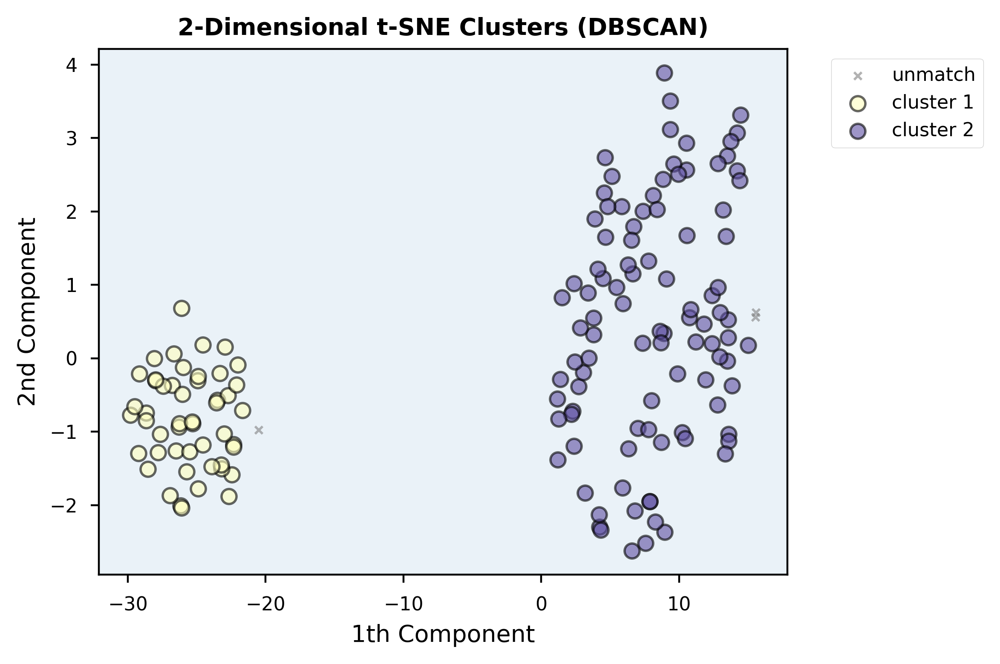

In [142]:
dbscan_iris.predict()

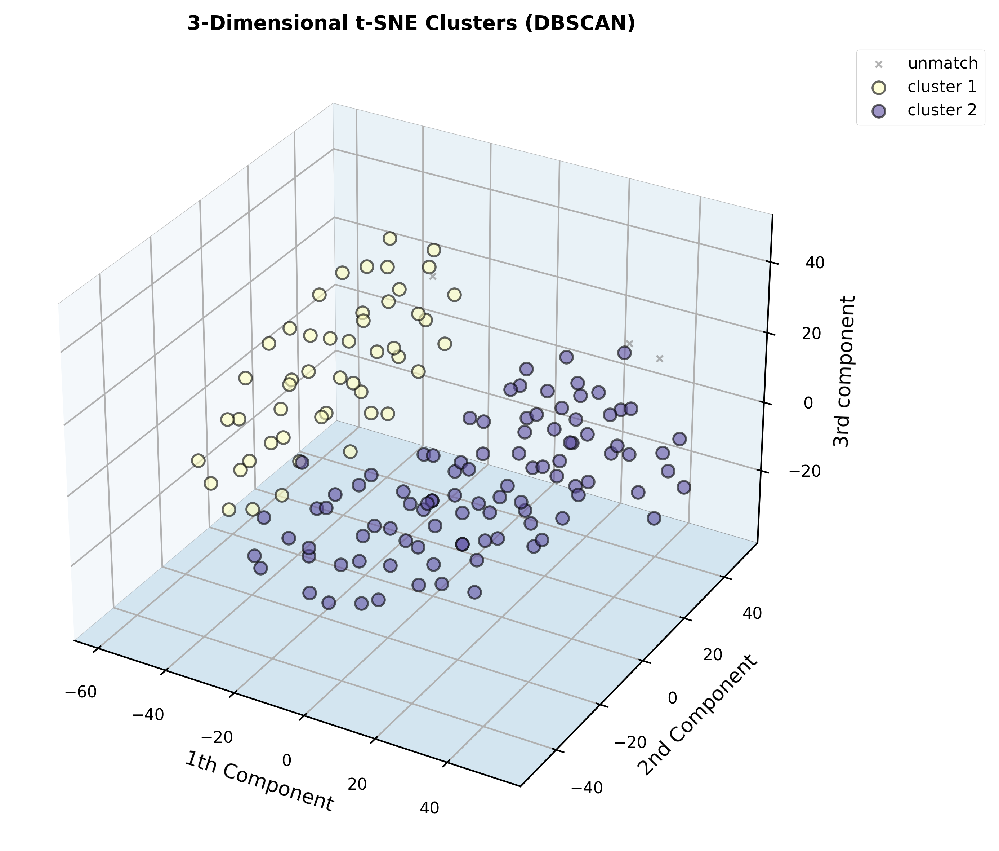

In [143]:
dbscan_iris.predict(projection='3d')

##### Uso personalizado (uso de argumentos opcionais)

In [144]:
dbscan_iris = asapy.DBSCAN(name='demo_dbscan_iris', seed=25)

In [145]:
dbscan_iris.build(df_iris, info=True)


                Total of registers: 150
                Total of valid registers: 150
                Total of invalid registers: 0

                Total of Features: 4
                Numerical Features: ['sepal length (cm)', 'sepal width (cm)', 'petal length (cm)', 'petal width (cm)']
                Categorical Features: []
                Categorical Features removed due to high cardinality: []
            


In [146]:
dbscan_iris.hyperparameter_optimization(
    n_trials=100,
    info=True,
    search_space_eps = [0.1, 0.3, 0.4, 0.5, 0.6, 0.7, 1],
    search_space_min_samples = [3, 4, 5, 6, 7],
    search_space_algorithm = ['auto'],
    search_space_leaf_size = [10, 20, 30, 40, 50],
    search_space_p = [2]
)

,Trial (nº),Silhouette Score,params_algorithm,params_eps,params_leaf_size,params_min_samples,params_p
Ranking,,,,,,,
1º,99,0.538288,auto,1.0,40,5,2
2º,47,0.538288,auto,1.0,10,4,2
3º,64,0.538288,auto,1.0,20,4,2
4º,34,0.538288,auto,1.0,30,4,2
5º,77,0.538288,auto,1.0,10,6,2
...,...,...,...,...,...,...,...
96º,16,-1.000000,auto,0.1,50,4,2
97º,36,-1.000000,auto,0.1,20,7,2
98º,18,-1.000000,auto,0.1,30,4,2


In [147]:
clusters = dbscan_iris.fit(return_cluster=True)

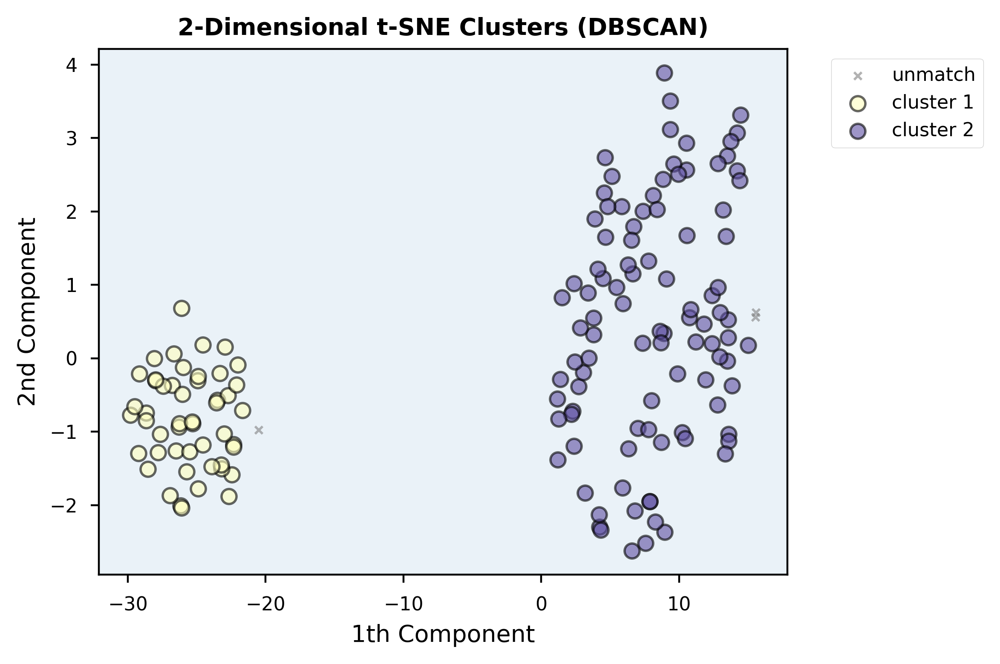

In [148]:
dbscan_iris.predict(projection='2d', graphic_save_extension='png')

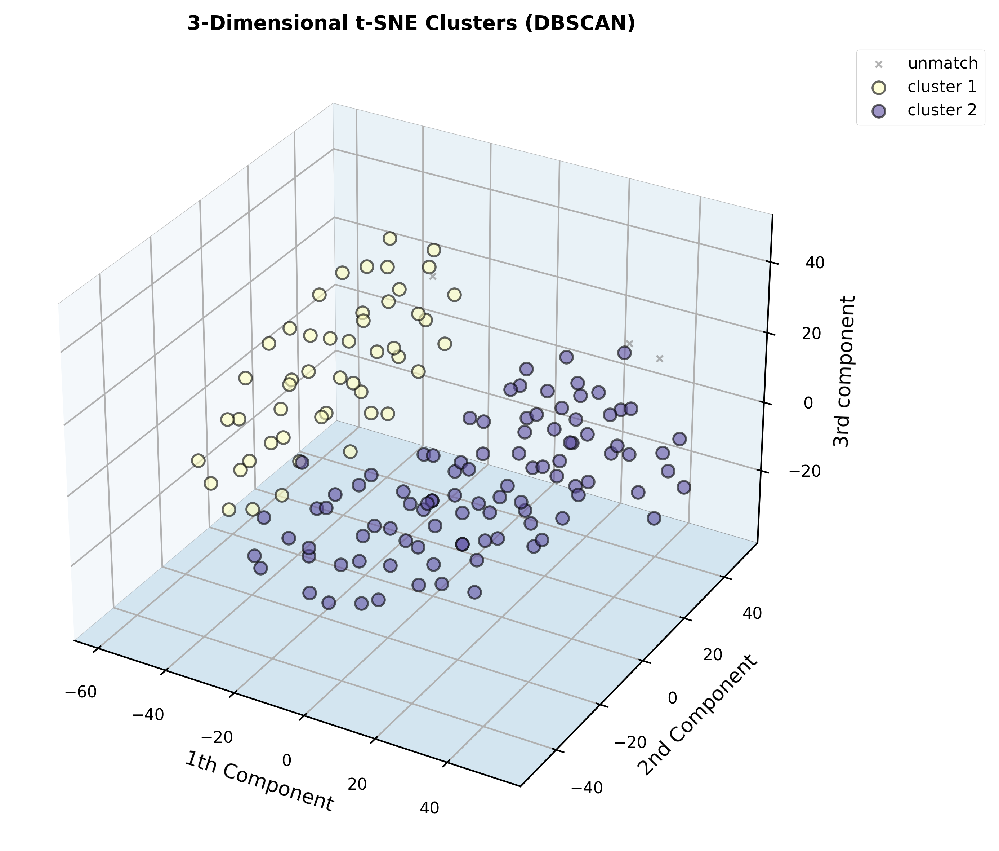

In [149]:
dbscan_iris.predict(projection='3d', graphic_save_extension='png')

##### Salvar modelo treinado

In [150]:
dbscan_iris.save()

##### Recuperar modelo treinado

In [151]:
foldername_dbscan_iris = 'demo_dbscan_iris'

In [152]:
dbscan_iris_loaded = asapy.DBSCAN()

In [153]:
dbscan_iris_loaded.load(foldername_dbscan_iris)

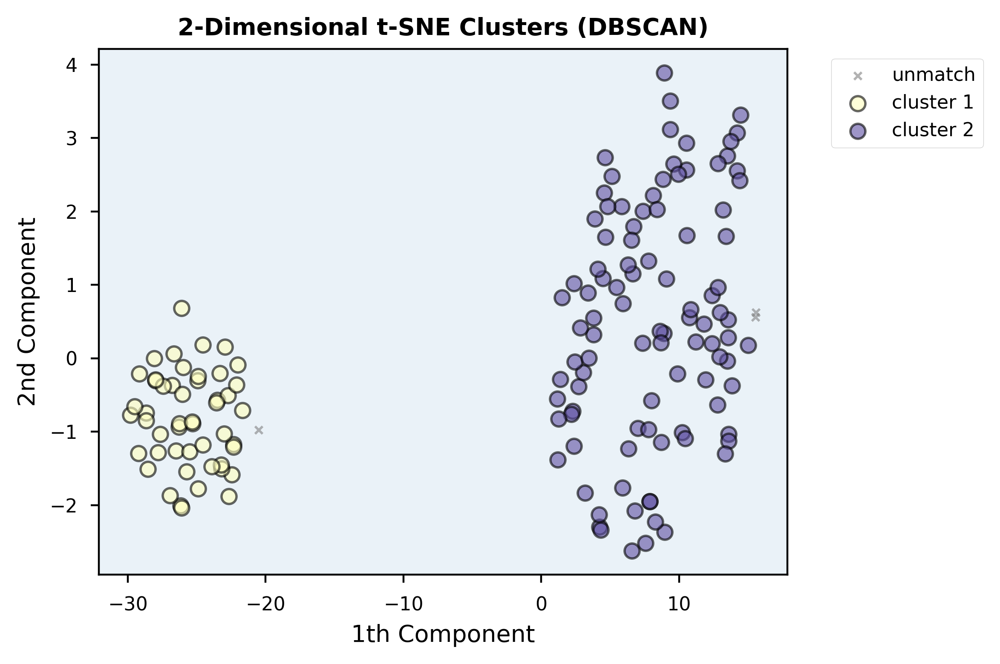

In [154]:
dbscan_iris_loaded.predict()

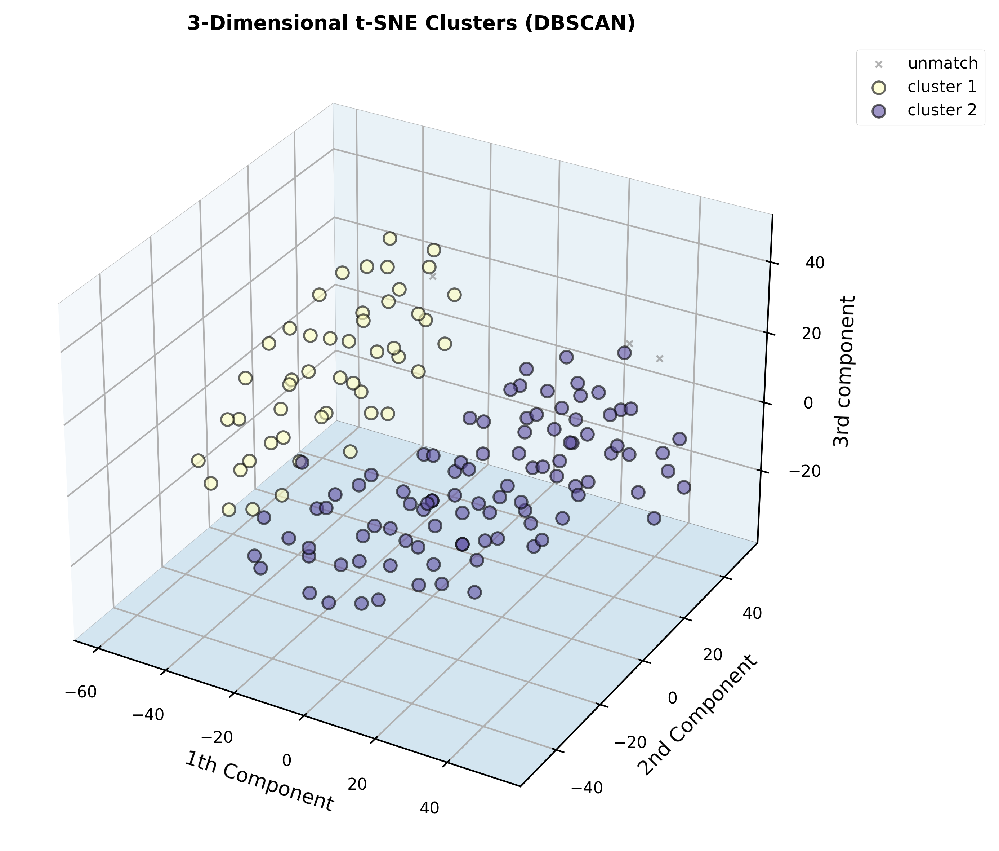

In [155]:
dbscan_iris_loaded.predict(projection='3d')

#### K-Means

##### Uso Simples

In [156]:
kmeans_iris = asapy.KMeans()

In [157]:
kmeans_iris.build(df_iris)

In [158]:
kmeans_iris.hyperparameter_optimization(search_space_n_clusters=[3])

In [159]:
kmeans_iris.fit()

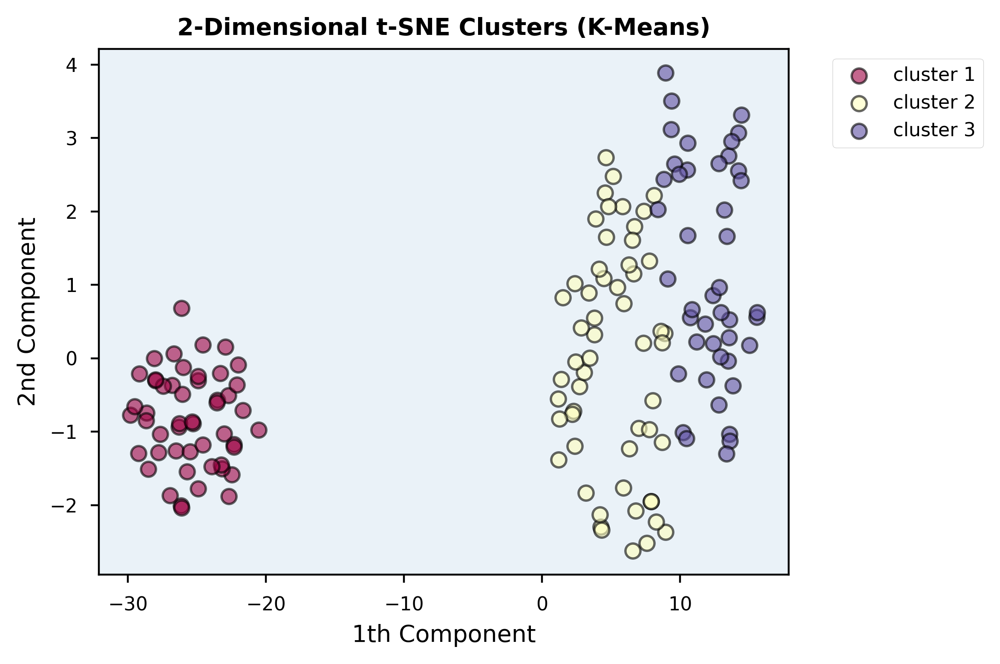

In [160]:
kmeans_iris.predict()

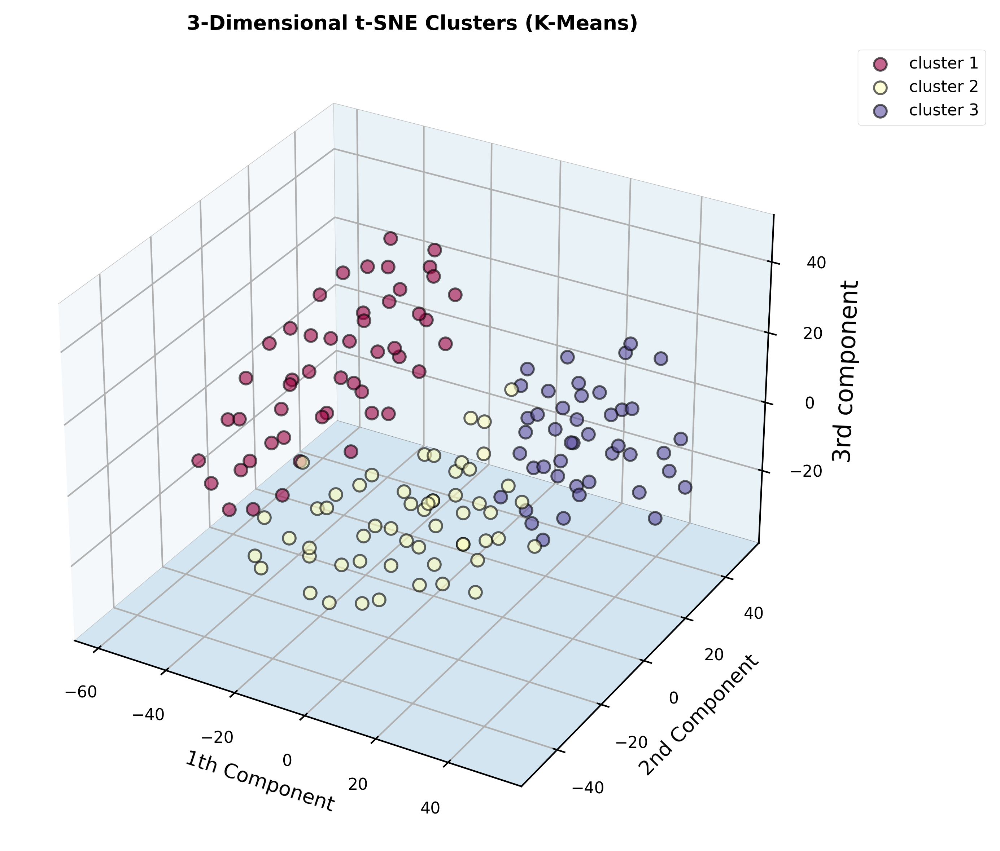

In [161]:
kmeans_iris.predict(projection='3d')

##### Uso personalizado (uso de argumentos opcionais)

In [162]:
kmeans_iris = asapy.KMeans(name='demo_kmeans_iris', seed=25)

In [163]:
kmeans_iris.build(df_iris, info=True)


                Total of registers: 150
                Total of valid registers: 150
                Total of invalid registers: 0

                Total of Features: 4
                Numerical Features: ['sepal length (cm)', 'sepal width (cm)', 'petal length (cm)', 'petal width (cm)']
                Categorical Features: []
                Categorical Features removed due to high cardinality: []
            


In [164]:
kmeans_iris.hyperparameter_optimization(
    n_trials=10,
    info=True,
    search_space_n_clusters=[3],
    search_space_init  = ['k-means++'],
    search_space_n_init = ['auto'],
    search_space_tol = [1e-5, 1e-4, 1e-3],
    search_space_algorithm = ['lloyd', 'elkan']
)

,Trial (nº),Silhouette Score,params_algorithm,params_init,params_n_clusters,params_n_init,params_tol
Ranking,,,,,,,
1º,0,0.456535,lloyd,k-means++,3,auto,0.00001
2º,1,0.456535,elkan,k-means++,3,auto,0.00010
3º,2,0.456535,lloyd,k-means++,3,auto,0.00100
4º,3,0.456535,elkan,k-means++,3,auto,0.00010
5º,4,0.456535,elkan,k-means++,3,auto,0.00001
6º,5,0.456535,lloyd,k-means++,3,auto,0.00001
7º,6,0.456535,elkan,k-means++,3,auto,0.00010
8º,7,0.456535,lloyd,k-means++,3,auto,0.00010
9º,8,0.456535,lloyd,k-means++,3,auto,0.00010


In [165]:
clusters = kmeans_iris.fit(return_cluster=True)

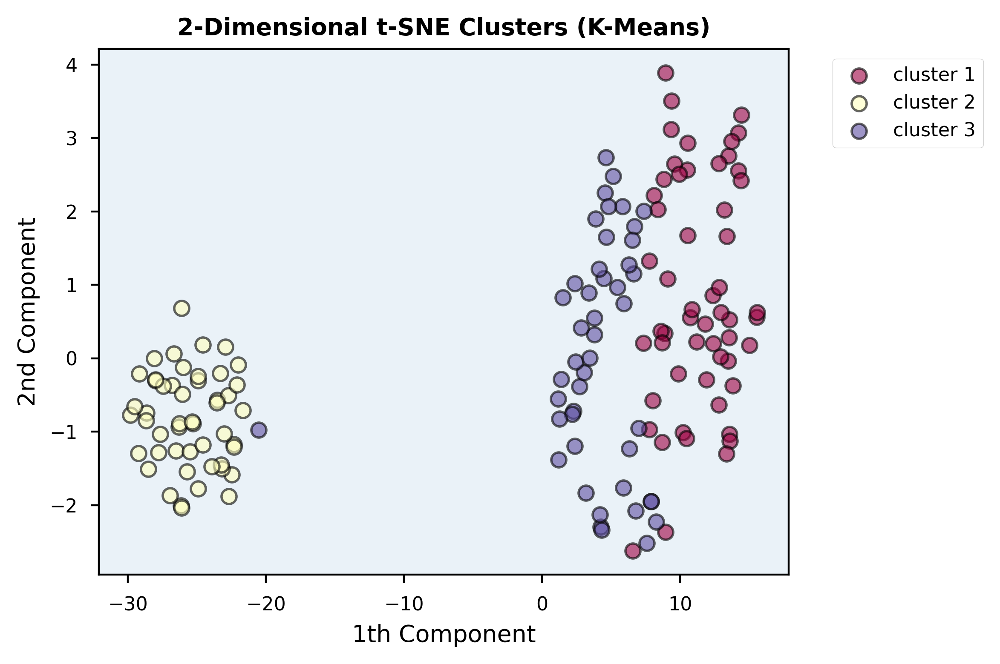

In [166]:
kmeans_iris.predict(projection='2d', graphic_save_extension='png')

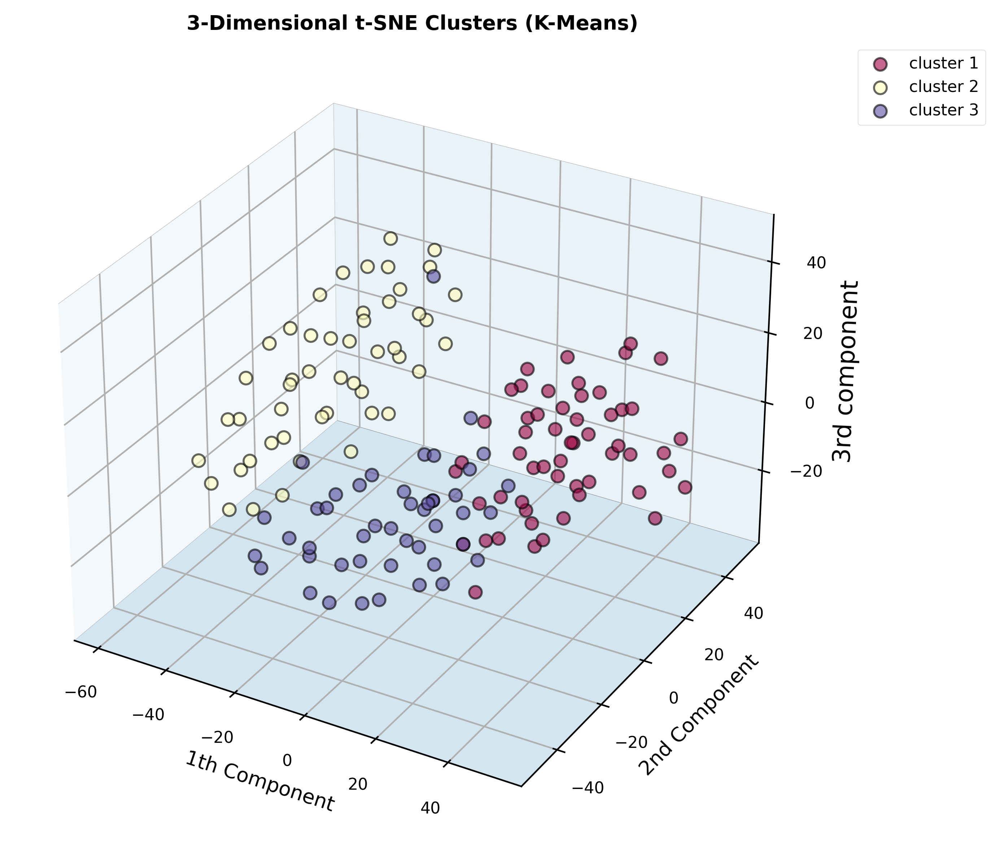

In [167]:
kmeans_iris.predict(projection='3d', graphic_save_extension='png')

##### Salvar modelo treinado

In [168]:
kmeans_iris.save()

##### Recuperar modelo treinado

In [169]:
foldername_kmeans_iris = 'demo_kmeans_iris'

In [170]:
kmeans_iris_loaded = asapy.DBSCAN()

In [171]:
kmeans_iris_loaded.load(foldername_kmeans_iris)

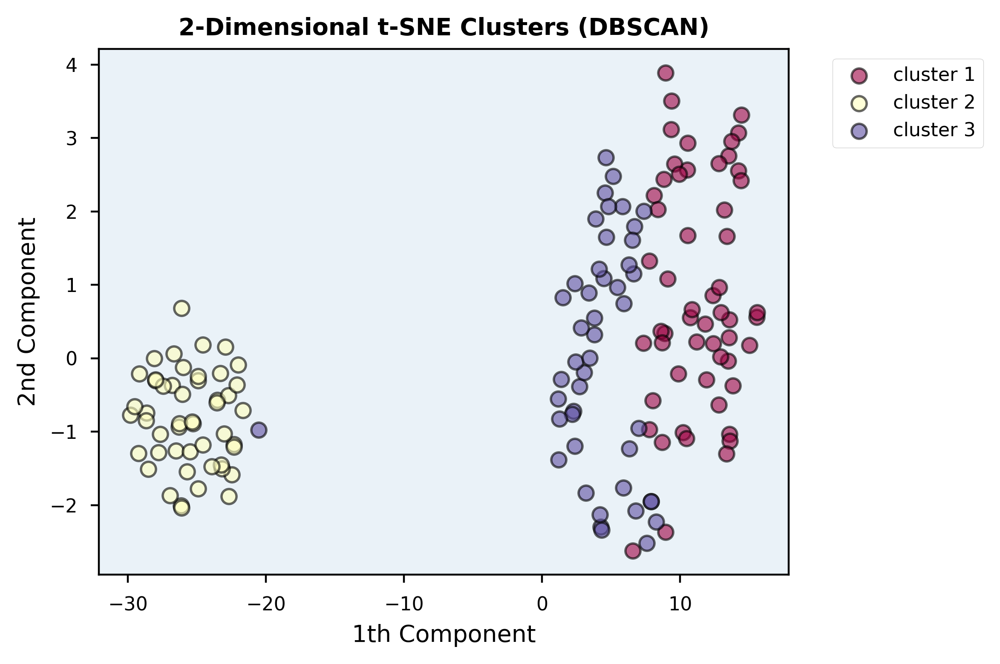

In [172]:
kmeans_iris_loaded.predict()

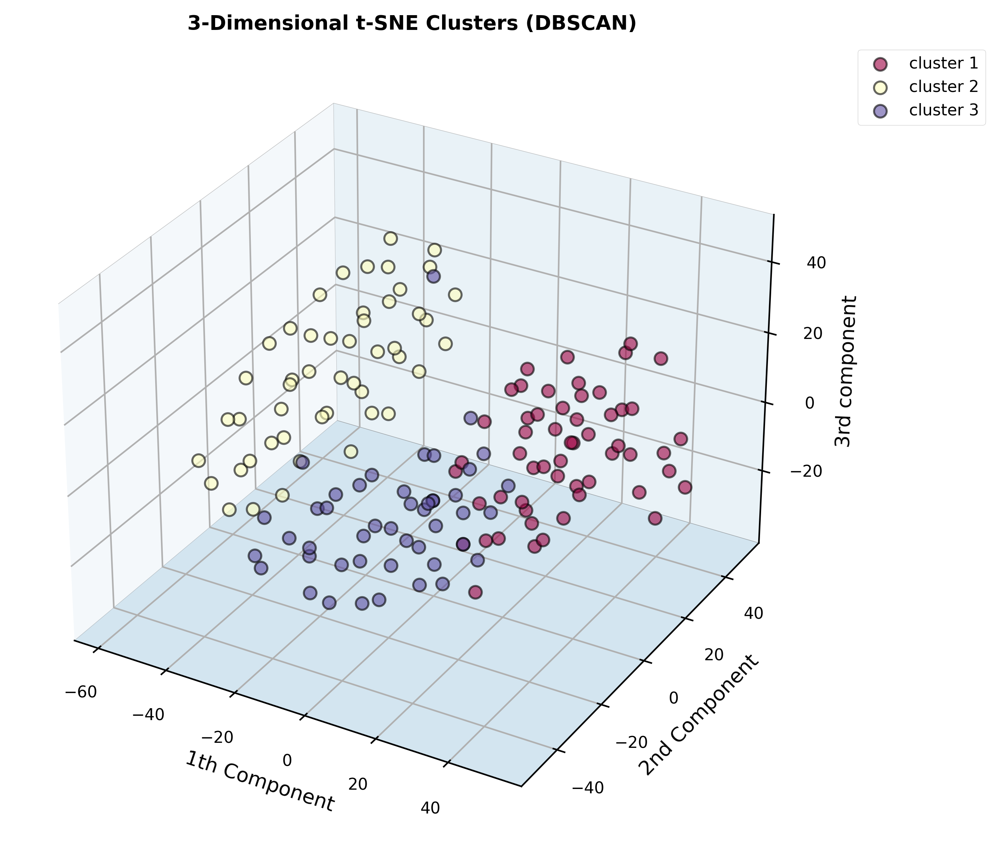

In [173]:
kmeans_iris_loaded.predict(projection='3d')

### Caso 6: [Titanic](https://www.kaggle.com/competitions/titanic)

In [174]:
df_titanic = load_dataset('titanic')
df_titanic.drop(columns=['deck', 'age'], inplace=True)
df_titanic.dropna(inplace=True)

In [175]:
sample_titanic = df_titanic.sample(5)
df_titanic.drop(sample_titanic.index, inplace=True)

In [176]:
df_titanic.head(5)

,survived,pclass,sex,sibsp,parch,fare,embarked,class,who,adult_male,embark_town,alive,alone
0,0,3,male,1,0,7.2500,S,Third,man,True,Southampton,no,False
1,1,1,female,1,0,71.2833,C,First,woman,False,Cherbourg,yes,False
2,1,3,female,0,0,7.9250,S,Third,woman,False,Southampton,yes,True
3,1,1,female,1,0,53.1000,S,First,woman,False,Southampton,yes,False
4,0,3,male,0,0,8.0500,S,Third,man,True,Southampton,no,True


#### DBSCAN

##### Uso Simples

In [177]:
dbscan_titanic = asapy.DBSCAN()

In [178]:
dbscan_titanic.build(df_titanic)

In [179]:
dbscan_titanic.hyperparameter_optimization()

In [180]:
dbscan_titanic.fit()

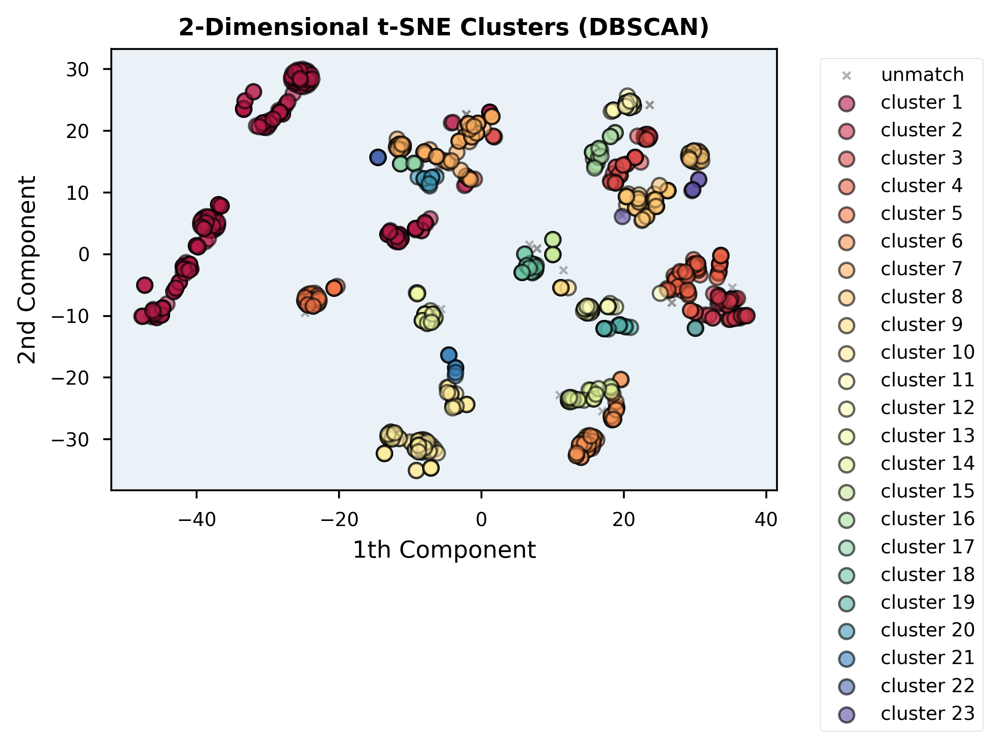

In [181]:
dbscan_titanic.predict()

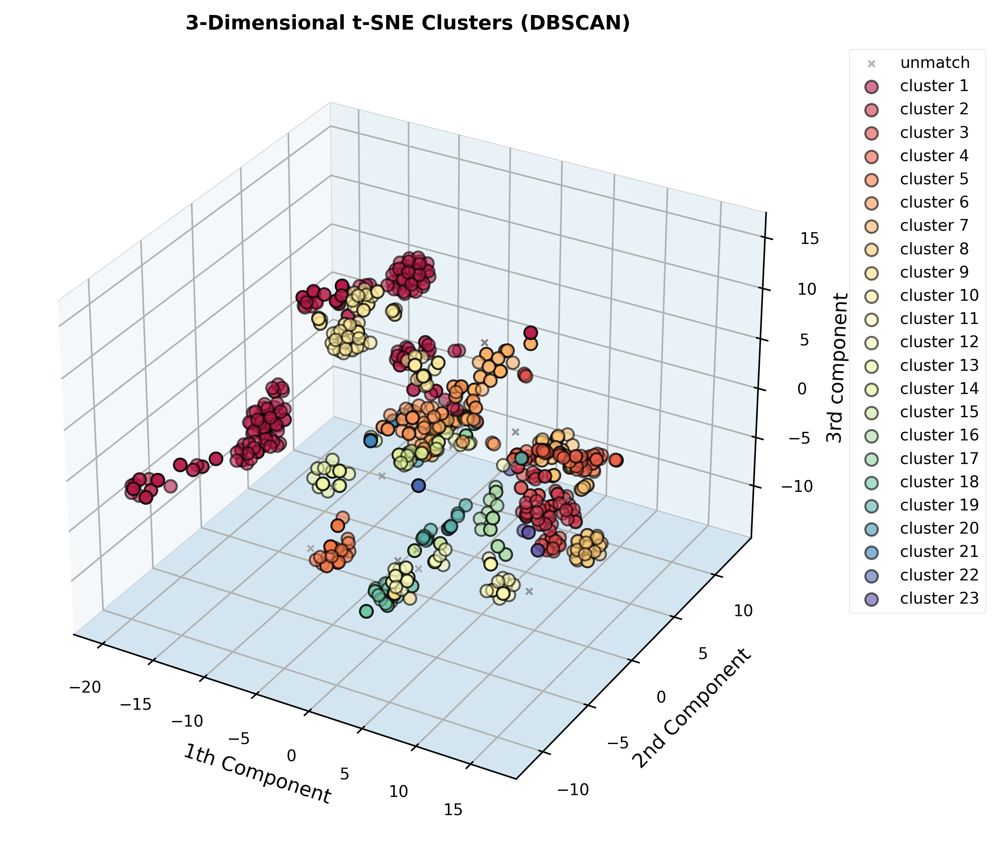

In [182]:
dbscan_titanic.predict(projection='3d')

##### Uso personalizado (uso de argumentos opcionais)

In [183]:
dbscan_titanic = asapy.DBSCAN(name='demo_dbscan_titanic', seed=25)

In [184]:
dbscan_titanic.build(df_titanic, info=True)


                Total of registers: 884
                Total of valid registers: 884
                Total of invalid registers: 0

                Total of Features: 13
                Numerical Features: ['survived', 'pclass', 'sibsp', 'parch', 'fare']
                Categorical Features: ['sex', 'embarked', 'class', 'who', 'adult_male', 'embark_town', 'alive', 'alone']
                Categorical Features removed due to high cardinality: []
            


In [185]:
dbscan_titanic.hyperparameter_optimization(
    n_trials=100,
    info=True,
    search_space_eps = [0.1, 0.3, 0.4, 0.5, 0.6, 0.7, 1],
    search_space_min_samples = [3, 4, 5, 6, 7],
    search_space_algorithm = ['auto'],
    search_space_leaf_size = [10, 20, 30, 40, 50],
    search_space_p = [2]
)

,Trial (nº),Silhouette Score,params_algorithm,params_eps,params_leaf_size,params_min_samples,params_p
Ranking,,,,,,,
1º,99,0.421864,auto,0.1,20,5,2
2º,52,0.421864,auto,0.1,20,5,2
3º,81,0.421864,auto,0.1,20,5,2
4º,38,0.421864,auto,0.1,50,5,2
5º,39,0.421864,auto,0.1,20,5,2
...,...,...,...,...,...,...,...
96º,1,-1.000000,auto,0.6,40,4,2
97º,55,-1.000000,auto,0.4,20,5,2
98º,59,-1.000000,auto,0.5,20,7,2


In [186]:
clusters = dbscan_titanic.fit(return_cluster=True)

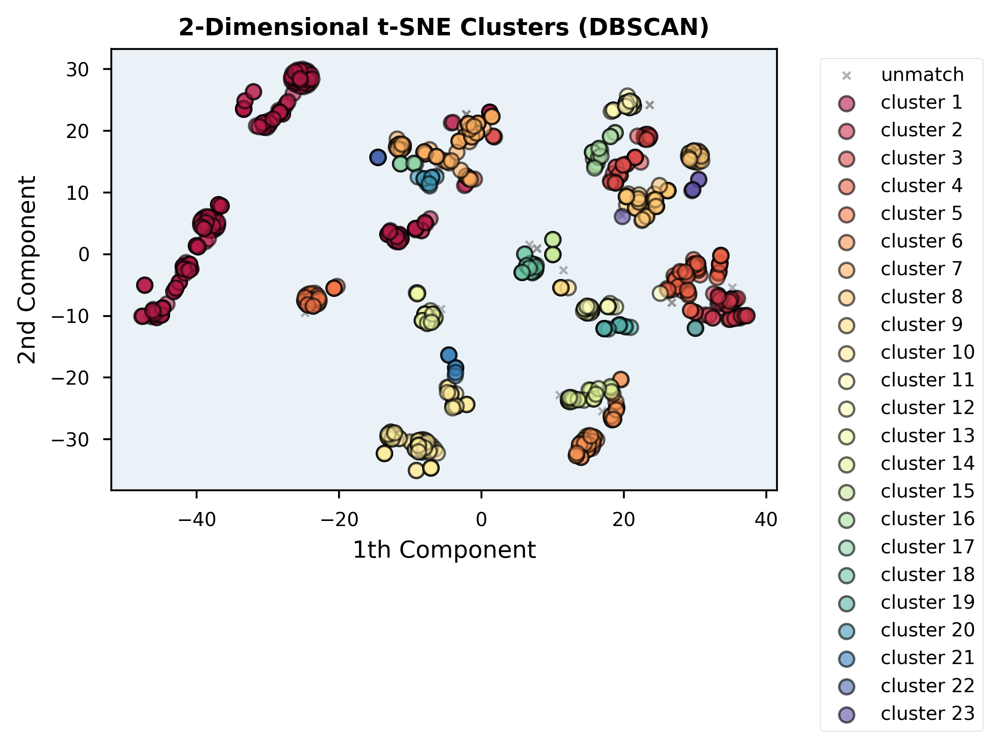

In [187]:
dbscan_titanic.predict(projection='2d', graphic_save_extension='png')

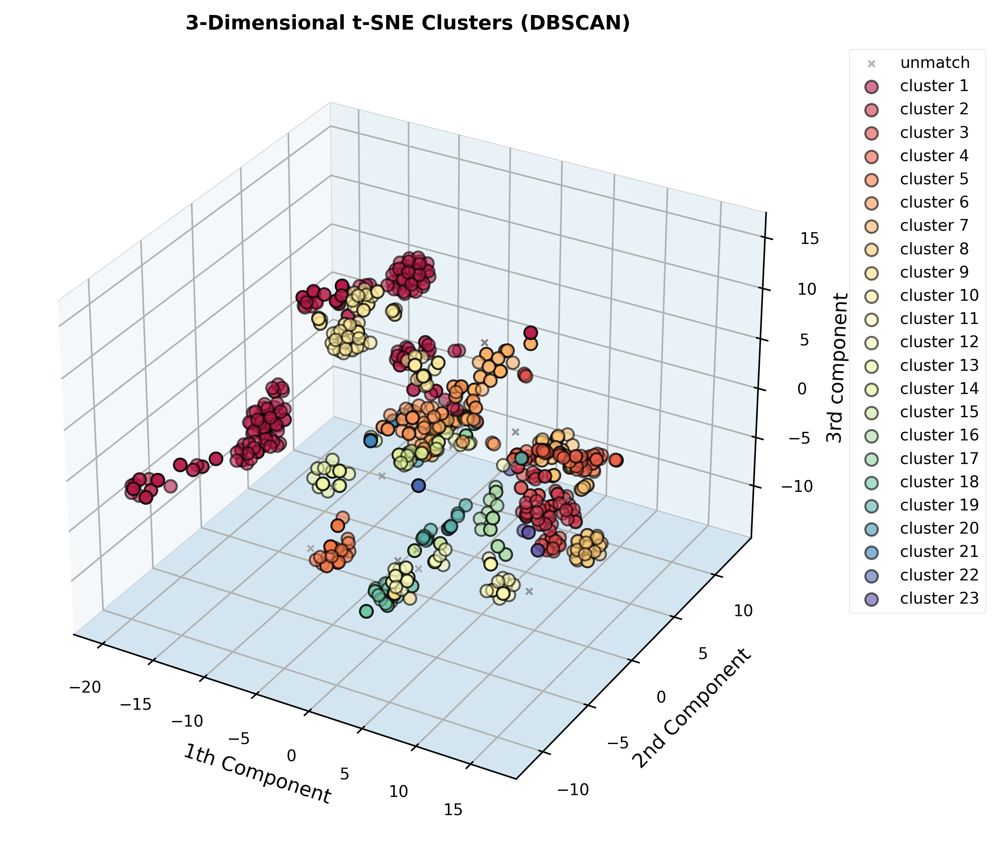

In [188]:
dbscan_titanic.predict(projection='3d', graphic_save_extension='png')

##### Salvar modelo treinado

In [189]:
dbscan_titanic.save()

##### Recuperar modelo treinado

In [190]:
foldername_dbscan_titanic = 'demo_dbscan_titanic'

In [191]:
dbscan_titanic_loaded = asapy.DBSCAN()

In [192]:
dbscan_titanic_loaded.load(foldername_dbscan_titanic)

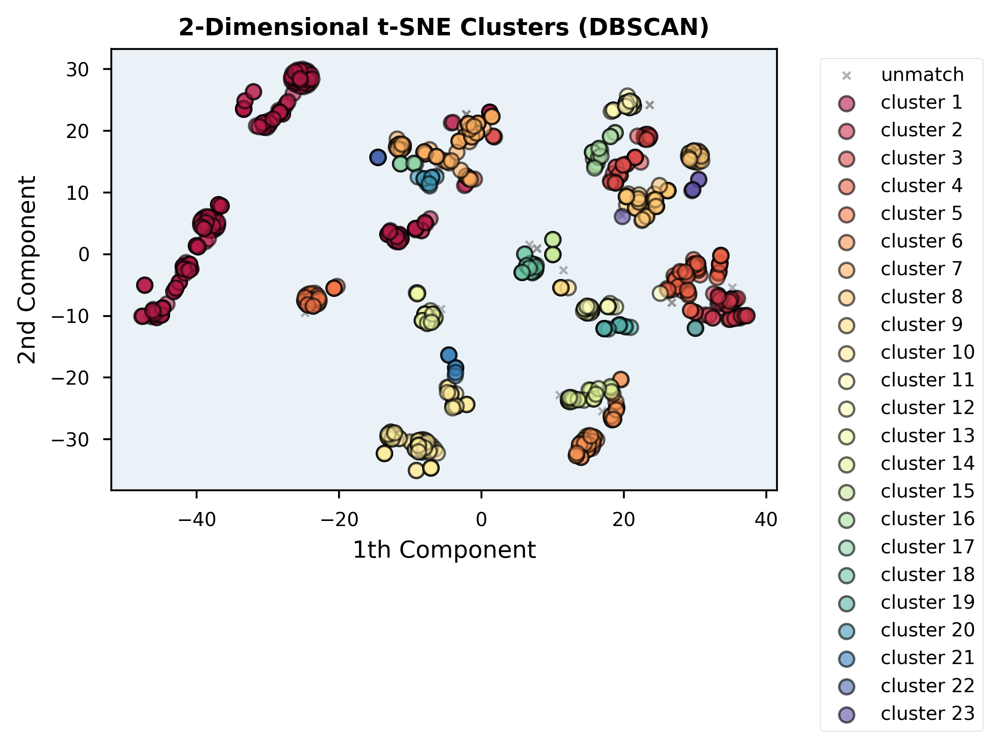

In [193]:
dbscan_titanic_loaded.predict()

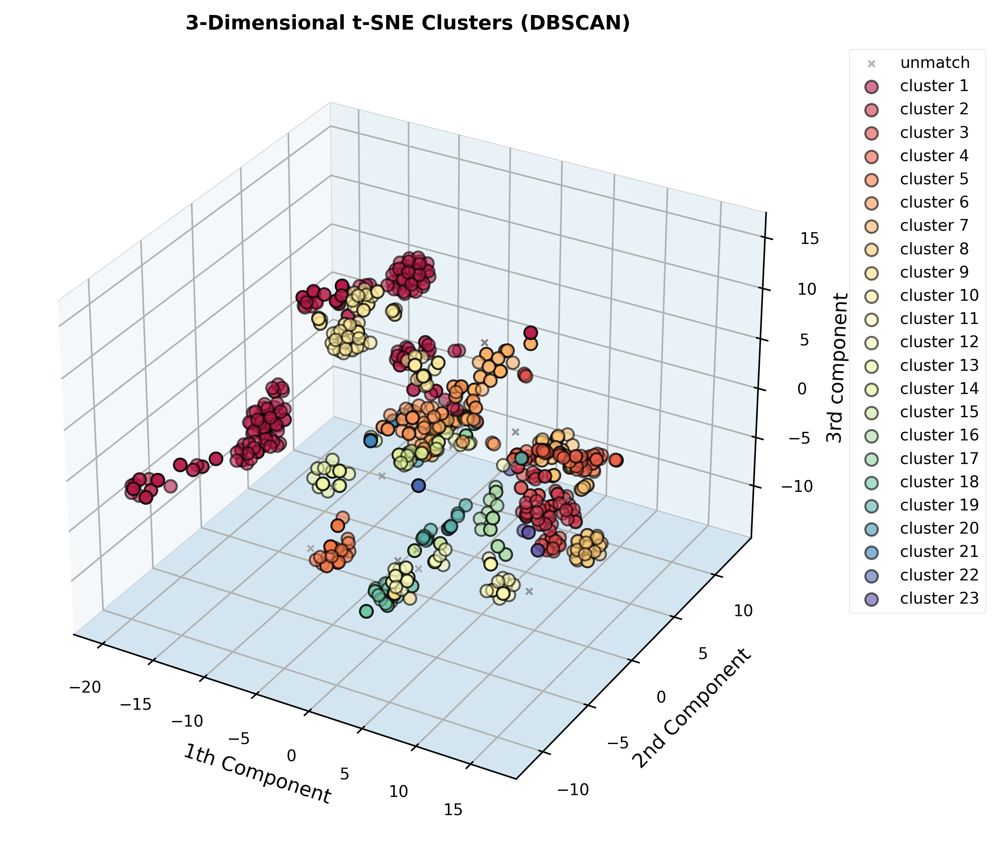

In [194]:
dbscan_titanic_loaded.predict(projection='3d')

#### K-Means

##### Uso Simples

In [195]:
kmeans_titanic = asapy.KMeans()

In [196]:
kmeans_titanic.build(df_titanic)

In [197]:
kmeans_titanic.hyperparameter_optimization(search_space_n_clusters=[2])

In [198]:
kmeans_titanic.fit()

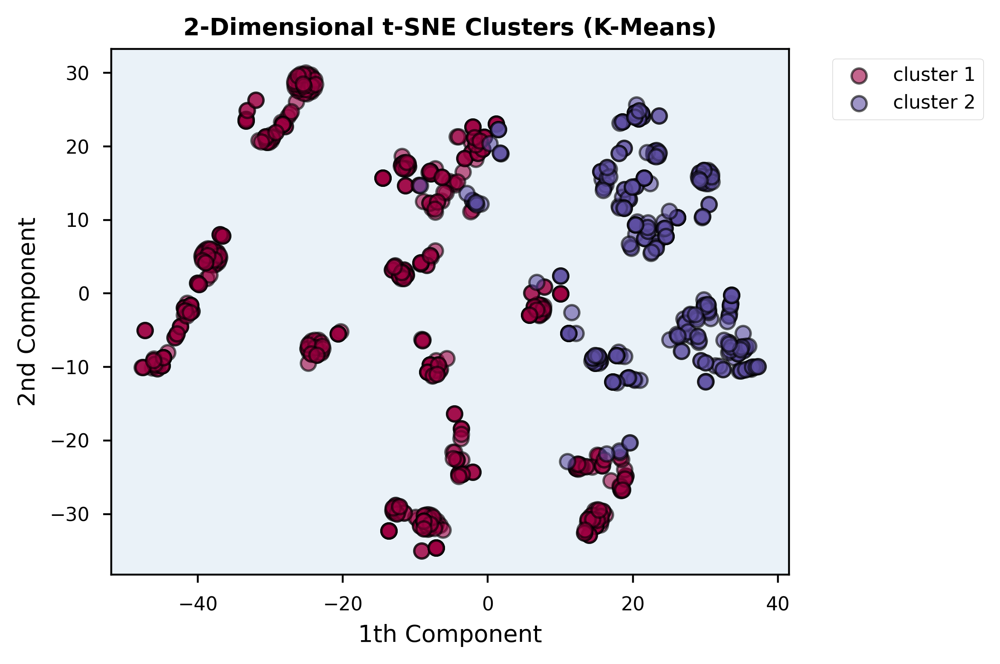

In [199]:
kmeans_titanic.predict()

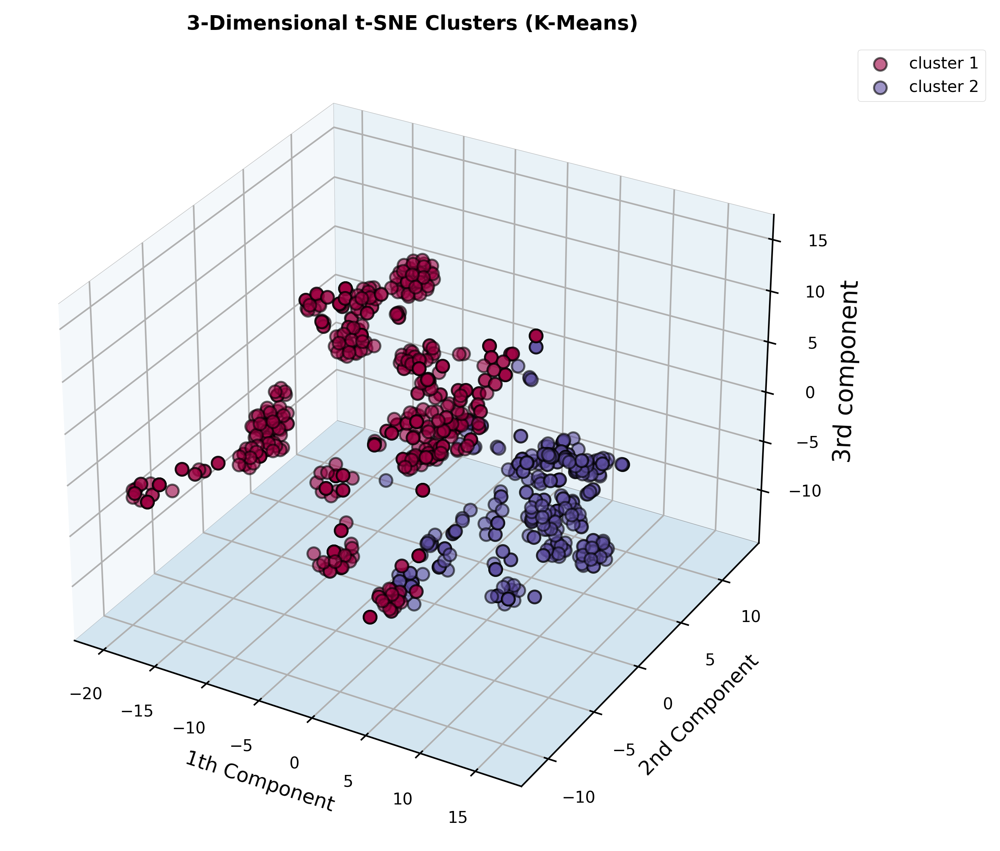

In [200]:
kmeans_titanic.predict(projection='3d')

##### Uso personalizado (uso de argumentos opcionais)

In [201]:
kmeans_titanic = asapy.KMeans(name='demo_kmeans_titanic', seed=25)

In [202]:
kmeans_titanic.build(df_titanic, info=True)


                Total of registers: 884
                Total of valid registers: 884
                Total of invalid registers: 0

                Total of Features: 13
                Numerical Features: ['survived', 'pclass', 'sibsp', 'parch', 'fare']
                Categorical Features: ['sex', 'embarked', 'class', 'who', 'adult_male', 'embark_town', 'alive', 'alone']
                Categorical Features removed due to high cardinality: []
            


In [203]:
kmeans_titanic.hyperparameter_optimization(
    n_trials=10,
    info=True,
    search_space_n_clusters=[2],
    search_space_init  = ['k-means++'],
    search_space_n_init = ['auto'],
    search_space_tol = [1e-5, 1e-4, 1e-3],
    search_space_algorithm = ['lloyd', 'elkan']
)

,Trial (nº),Silhouette Score,params_algorithm,params_init,params_n_clusters,params_n_init,params_tol
Ranking,,,,,,,
1º,0,0.315615,elkan,k-means++,2,auto,0.00010
2º,1,0.315615,lloyd,k-means++,2,auto,0.00100
3º,2,0.315615,elkan,k-means++,2,auto,0.00010
4º,3,0.315615,lloyd,k-means++,2,auto,0.00010
5º,4,0.315615,elkan,k-means++,2,auto,0.00100
6º,5,0.315615,elkan,k-means++,2,auto,0.00100
7º,6,0.315615,elkan,k-means++,2,auto,0.00001
8º,7,0.315615,elkan,k-means++,2,auto,0.00010
9º,8,0.315615,lloyd,k-means++,2,auto,0.00010


In [204]:
clusters = kmeans_titanic.fit(return_cluster=True)

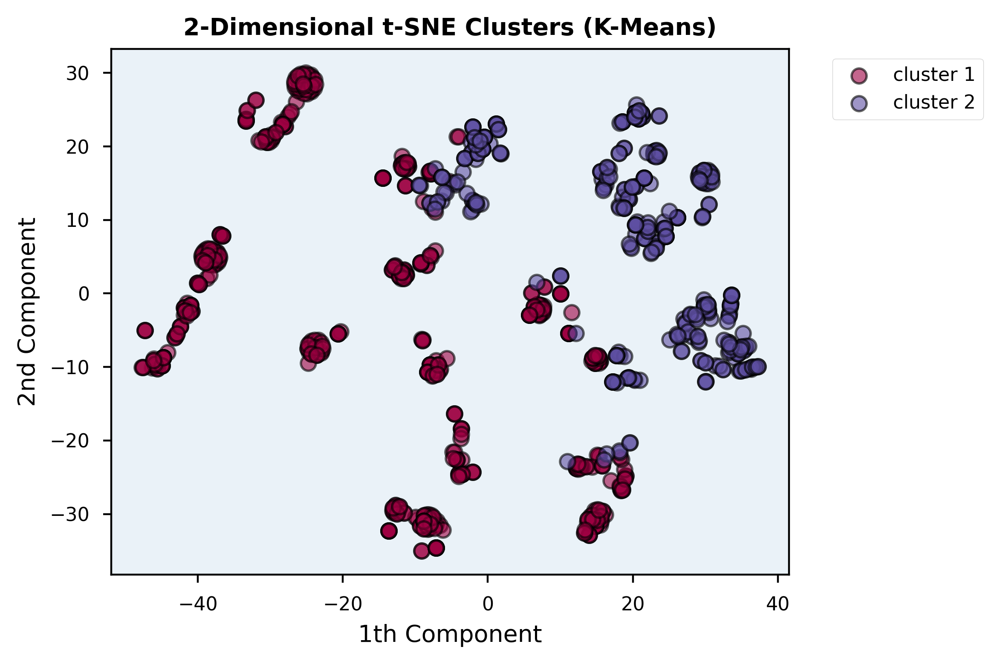

In [205]:
kmeans_titanic.predict(projection='2d', graphic_save_extension='png')

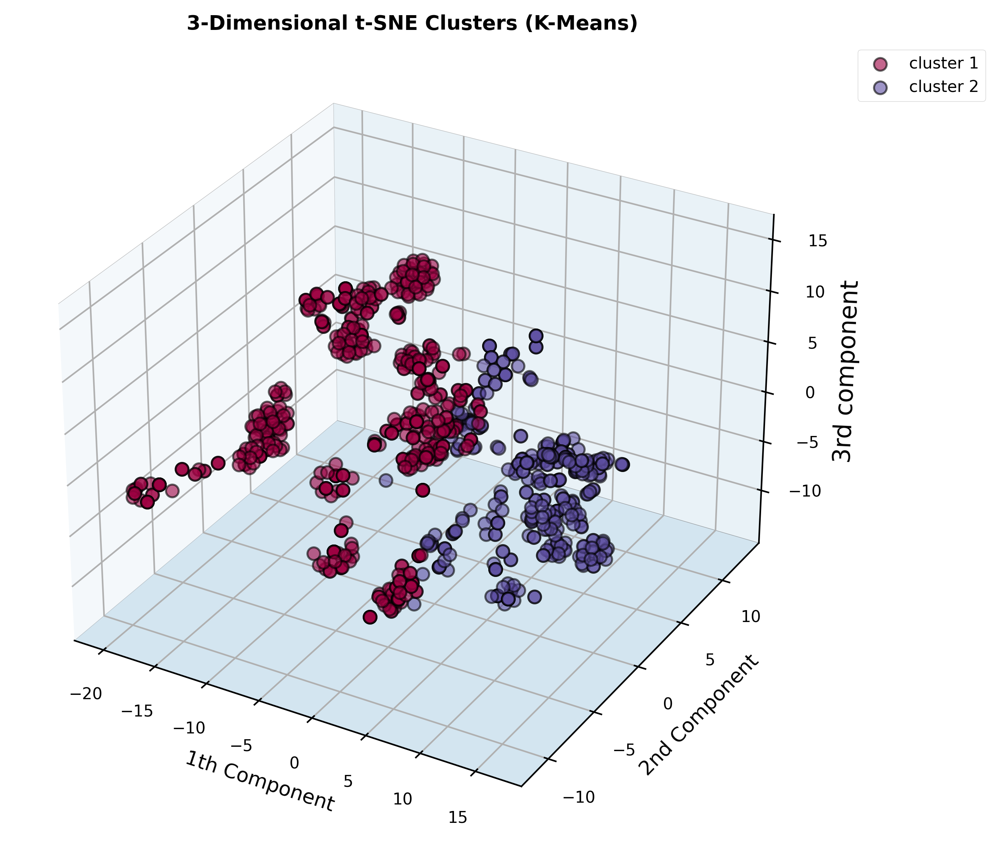

In [206]:
kmeans_titanic.predict(projection='3d', graphic_save_extension='png')

##### Salvar modelo treinado

In [207]:
kmeans_titanic.save()

##### Recuperar modelo treinado

In [208]:
foldername_kmeans_titanic = 'demo_kmeans_titanic'

In [209]:
kmeans_titanic_loaded = asapy.KMeans()

In [210]:
kmeans_titanic_loaded.load(foldername_kmeans_titanic)

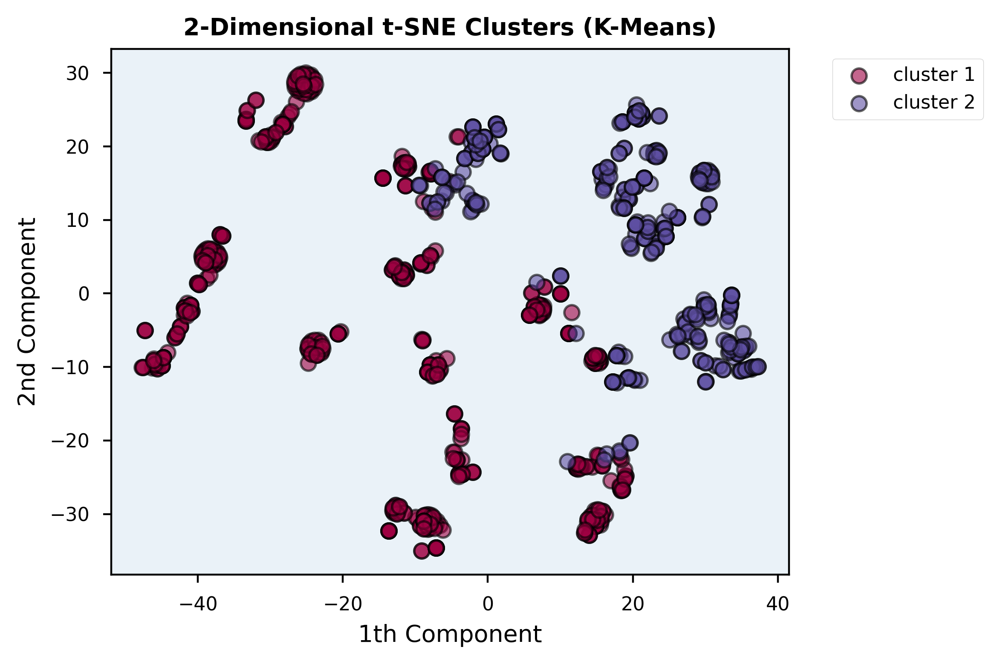

In [211]:
kmeans_titanic_loaded.predict()

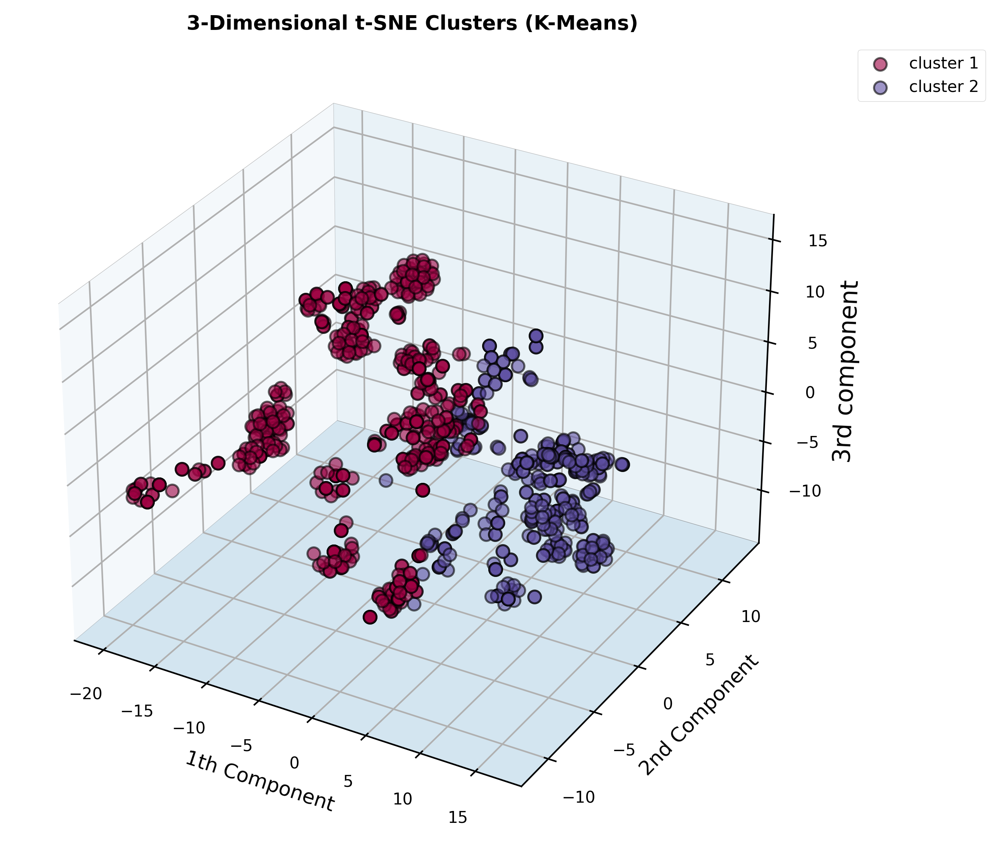

In [212]:
kmeans_titanic_loaded.predict(projection='3d')